In [1]:
import pandas as pd
import geopy
import seaborn as sns
import geopandas as gpd
import json

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import warnings
import plotly.express as px
warnings.filterwarnings('ignore')
sns.set()

import ipywidgets as widgets
from ipywidgets import interact,Dropdown, FloatSlider
from traitlets import directional_link
from IPython.display import display

from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import FunctionTransformer, OneHotEncoder, OrdinalEncoder
from sklearn.preprocessing import KBinsDiscretizer
from sklearn.preprocessing import StandardScaler, MinMaxScaler,QuantileTransformer, PowerTransformer, RobustScaler
from sklearn.compose import ColumnTransformer
from sklearn.model_selection import GroupShuffleSplit
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from xgboost import XGBRegressor
from sklearn.ensemble import HistGradientBoostingRegressor
from sklearn.linear_model import PoissonRegressor
from sklearn.linear_model import TweedieRegressor
from sklearn.linear_model import GammaRegressor
from sklearn.metrics import make_scorer, mean_squared_error, mean_absolute_error, r2_score, mean_poisson_deviance
from sklearn.model_selection import cross_val_score, KFold, StratifiedGroupKFold

In [2]:
# Generuję plik z wymaganiami dotyczącymi środowiska
!pip freeze > requirements.txt

In [3]:
df = pd.read_csv("modelowanie_pricing_EH.csv", error_bad_lines=False)

Skipping line 655: expected 13 fields, saw 14
Skipping line 1437: expected 13 fields, saw 14

Skipping line 123125: expected 13 fields, saw 14

Skipping line 381013: expected 13 fields, saw 14

Skipping line 547536: expected 13 fields, saw 14



In [16]:
import qgrid
qgrid.show_grid(df)

QgridWidget(grid_options={'fullWidthRows': True, 'syncColumnCellResize': True, 'forceFitColumns': True, 'defau…

In [12]:
!jupyter nbextension enable --py --sys-prefix qgrid

Enabling notebook extension qgrid/extension...
      - Validating: OK


In [14]:
!jupyter nbextension enable --py --sys-prefix widgetsnbextension

Enabling notebook extension jupyter-js-widgets/extension...
      - Validating: OK


# 1. Zapoznanie z datasetem 
### Features:
* IDpol: policy number (unique identifier);
* Exposure: total exposure in yearly units (years-at-risk) and within (0, 1];
* Area: area code (categorical, ordinal with 6 levels); The density value of the city community where the car driver lives in: from "A" for rural area to "F" for urban centre. 
* VehPower: power of the car (continuous);
* VehAge: age of the car in years;
* DrivAge: age of the (most common) driver in years;
* BonusMalus: bonus-malus level between 50 and 230 (with entrance level 100);
* VehBrand: car brand (categorical, nominal with 11 levels);
* VehGas: diesel or regular fuel car (binary);
* Density: density of population per km2 at the location of the living place of the driver;
* Region: regions in France (prior to 2016)
  
### Target
* Frequency = Number of claims / Exposure

Podczas wczytywania pominięte zostały cztery rekordy (na końcach tych linii znajduje się ',' jako separator, można to naprawić 'ręcznie' w pliku *.csv). W przypadku tak dużego zbioru  utrata danych z 4 rekordów nie jest istotna. 

In [3]:
df.head()

,IDpol,ClaimNb,Exposure,Area,VehPower,VehAge,DrivAge,BonusMalus,VehBrand,VehGas,Density,Region
0,1.0,1.0,0.10,D,5.0,0.0,55.0,50.0,B12,Regular,1217.0,R82
1,3.0,1.0,0.77,D,5.0,0.0,55.0,50.0,B12,Regular,1217.0,R82
2,5.0,1.0,0.75,B,6.0,2.0,52.0,50.0,B12,Diesel,54.0,R22
3,10.0,1.0,0.09,NaN,7.0,0.0,46.0,50.0,B12,Diesel,76.0,R72
4,11.0,1.0,0.84,B,7.0,0.0,46.0,50.0,B12,Diesel,76.0,R72


#### Analiza typów zmiennych w tabeli i liczby rekordów dla każdej zmiennej

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 678008 entries, 0 to 678012
Data columns (total 12 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   IDpol       678008 non-null  float64
 1   ClaimNb     678007 non-null  float64
 2   Exposure    678007 non-null  float64
 3   Area        678007 non-null  object 
 4   VehPower    678007 non-null  float64
 5   VehAge      678007 non-null  float64
 6   DrivAge     678007 non-null  float64
 7   BonusMalus  678007 non-null  float64
 8   VehBrand    678007 non-null  object 
 9   VehGas      678007 non-null  object 
 10  Density     678007 non-null  float64
 11  Region      678007 non-null  object 
dtypes: float64(8), object(4)
memory usage: 67.2+ MB


In [4]:
# Ilość pustych komórek (NaN)
for column in df.columns:
    missing = df[column].isna().sum()
    print(f"{column:{25}}: ==============> {missing}")

IDpol                    : ==============> 0
ClaimNb                  : ==============> 1
Exposure                 : ==============> 1
Area                     : ==============> 1
VehPower                 : ==============> 1
VehAge                   : ==============> 1
DrivAge                  : ==============> 1
BonusMalus               : ==============> 1
VehBrand                 : ==============> 1
VehGas                   : ==============> 1
Density                  : ==============> 1
Region                   : ==============> 1


In [5]:
df.dropna(inplace=True)

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 677997 entries, 0 to 678012
Data columns (total 12 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   IDpol       677997 non-null  float64
 1   ClaimNb     677997 non-null  float64
 2   Exposure    677997 non-null  float64
 3   Area        677997 non-null  object 
 4   VehPower    677997 non-null  float64
 5   VehAge      677997 non-null  float64
 6   DrivAge     677997 non-null  float64
 7   BonusMalus  677997 non-null  float64
 8   VehBrand    677997 non-null  object 
 9   VehGas      677997 non-null  object 
 10  Density     677997 non-null  float64
 11  Region      677997 non-null  object 
dtypes: float64(8), object(4)
memory usage: 67.2+ MB


Wartości np.NaN - z uwagi na duzy rozmiar zbioru, usuwam rekordy z pustymi komórkami.

In [7]:
# Ilość duplikatów w zbiorze danych
df.duplicated().sum()

0

In [8]:
# Zbędne kolumny - ID polisy
df = df.drop(['IDpol'], axis=1)

In [9]:
df.head()

,ClaimNb,Exposure,Area,VehPower,VehAge,DrivAge,BonusMalus,VehBrand,VehGas,Density,Region
0,1.0,0.10,D,5.0,0.0,55.0,50.0,B12,Regular,1217.0,R82
1,1.0,0.77,D,5.0,0.0,55.0,50.0,B12,Regular,1217.0,R82
2,1.0,0.75,B,6.0,2.0,52.0,50.0,B12,Diesel,54.0,R22
4,1.0,0.84,B,7.0,0.0,46.0,50.0,B12,Diesel,76.0,R72
5,1.0,0.52,E,6.0,2.0,38.0,50.0,B12,Regular,3003.0,R31


### Podział administracyjny Francji

Do 2016 roku kraj dzielił się na regionów 27 regionów (w tym 5 regionów zamorskich). Po ustaleniu nowego podziału administracyjnego (część regionów została połączona w jeden) jest to 18 regionów, w tym 5 to terytoria zamorskie. Chcąc przedstawić część wyników analizy w odniesieniu do obecnego podziału terytorialnego, uaktualniam nazwy regionów zgdnie z obowiązującą konwencją.

In [10]:
gf = gpd.read_file('regions.geojson')
gf = gf.rename(columns={'code': 'Region'})

In [11]:
gf

,Region,nom,geometry
0,11,Île-de-France,"POLYGON ((1.92215 48.45760, 1.92074 48.44775, ..."
1,24,Centre-Val de Loire,"POLYGON ((0.81482 48.67016, 0.82767 48.68072, ..."
2,27,Bourgogne-Franche-Comté,"POLYGON ((6.94054 47.43337, 6.94168 47.41580, ..."
3,28,Normandie,"POLYGON ((-1.11962 49.35557, -1.11503 49.36240..."
4,32,Hauts-de-France,"POLYGON ((4.14089 49.97876, 4.15398 49.97484, ..."
5,44,Grand Est,"POLYGON ((3.41479 48.39027, 3.42208 48.41334, ..."
6,52,Pays de la Loire,"MULTIPOLYGON (((-2.30479 46.70942, -2.28612 46..."
7,53,Bretagne,"MULTIPOLYGON (((-2.12371 48.60441, -2.13448 48..."
8,75,Nouvelle-Aquitaine,"MULTIPOLYGON (((-1.02574 45.57469, -0.99300 45..."
9,01,Guadeloupe,"MULTIPOLYGON (((-61.63356 15.83977, -61.64798 ..."


In [12]:
fig = px.choropleth_mapbox(gf,
                   geojson=gf.geometry,
                   locations=gf.index,
                   center = {"lat": 48.8566, "lon": 2.3522},
                   color="nom",
                   mapbox_style = 'open-street-map',
                   zoom=4)

fig.update_geos(fitbounds="locations", visible=False)

fig.show()

In [13]:
df["Region"] = df["Region"].apply(lambda x: str(x)[1:])

In [14]:
regions_new_old = {'11':['11'],
                    '24':['24'], 
                    '27':['26','43'], 
                    '28':['23','25'], 
                    '32':['22','31'], 
                    '44':['21','41','42'], 
                    '52':['52'],
                    '53':['53'], 
                    '75':['72','74','54'], 
                    '76':['73','91'],
                    '84':['82','83'],
                    '93':['93'],
                    '94':['94'],
                    '01':['01'],
                    '02':['02'],
                    '03':['03'],
                    '04':['04'],
                    '06':['06'],
}

In [15]:
def rename_regions(regions:dict, x):
    for key,val in regions.items():
        if x in val:
            x = key
        else:
            continue
    return x

In [16]:
df["Region"] = df["Region"].apply(lambda x: rename_regions(regions_new_old, x))

In [18]:
df

,ClaimNb,Exposure,Area,VehPower,VehAge,DrivAge,BonusMalus,VehBrand,VehGas,Density,Region
0,1.0,0.10000,D,5.0,0.0,55.0,50.0,B12,Regular,1217.0,84
1,1.0,0.77000,D,5.0,0.0,55.0,50.0,B12,Regular,1217.0,84
2,1.0,0.75000,B,6.0,2.0,52.0,50.0,B12,Diesel,54.0,32
4,1.0,0.84000,B,7.0,0.0,46.0,50.0,B12,Diesel,76.0,75
5,1.0,0.52000,E,6.0,2.0,38.0,50.0,B12,Regular,3003.0,32
...,...,...,...,...,...,...,...,...,...,...,...
678008,0.0,0.00274,E,4.0,0.0,54.0,50.0,B12,Regular,3317.0,93
678009,0.0,0.00274,E,4.0,0.0,41.0,95.0,B12,Regular,9850.0,11
678010,0.0,0.00274,D,6.0,2.0,45.0,50.0,B12,Diesel,1323.0,84
678011,0.0,0.00274,B,4.0,0.0,60.0,50.0,B12,Regular,95.0,27


In [19]:
df2 = pd.merge(df, gf[["Region","nom"]], on="Region")
df2

,ClaimNb,Exposure,Area,VehPower,VehAge,DrivAge,BonusMalus,VehBrand,VehGas,Density,Region,nom
0,1.0,0.100000,D,5.0,0.0,55.0,50.0,B12,Regular,1217.0,84,Auvergne-Rhône-Alpes
1,1.0,0.770000,D,5.0,0.0,55.0,50.0,B12,Regular,1217.0,84,Auvergne-Rhône-Alpes
2,1.0,0.690000,A,6.0,0.0,60.0,51.0,B12,Diesel,12.0,84,Auvergne-Rhône-Alpes
3,1.0,0.160000,A,6.0,0.0,60.0,51.0,B12,Diesel,12.0,84,Auvergne-Rhône-Alpes
4,2.0,0.750000,C,5.0,0.0,33.0,66.0,B12,Regular,151.0,84,Auvergne-Rhône-Alpes
...,...,...,...,...,...,...,...,...,...,...,...,...
677992,0.0,0.030000,C,4.0,0.0,70.0,50.0,B12,Regular,174.0,28,Normandie
677993,0.0,0.040000,D,4.0,0.0,55.0,50.0,B12,Regular,796.0,28,Normandie
677994,0.0,0.030000,D,9.0,0.0,54.0,50.0,B12,Diesel,867.0,28,Normandie
677995,0.0,0.008219,A,4.0,0.0,78.0,50.0,B12,Regular,27.0,28,Normandie


### Podział zmiennych na numeryczne (ciągłe i dyskretne), kategoryczne oraz target

In [20]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 677997 entries, 0 to 677996
Data columns (total 12 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   ClaimNb     677997 non-null  float64
 1   Exposure    677997 non-null  float64
 2   Area        677997 non-null  object 
 3   VehPower    677997 non-null  float64
 4   VehAge      677997 non-null  float64
 5   DrivAge     677997 non-null  float64
 6   BonusMalus  677997 non-null  float64
 7   VehBrand    677997 non-null  object 
 8   VehGas      677997 non-null  object 
 9   Density     677997 non-null  float64
 10  Region      677997 non-null  object 
 11  nom         677997 non-null  object 
dtypes: float64(7), object(5)
memory usage: 67.2+ MB


In [21]:
df2.head()

,ClaimNb,Exposure,Area,VehPower,VehAge,DrivAge,BonusMalus,VehBrand,VehGas,Density,Region,nom
0,1.0,0.10,D,5.0,0.0,55.0,50.0,B12,Regular,1217.0,84,Auvergne-Rhône-Alpes
1,1.0,0.77,D,5.0,0.0,55.0,50.0,B12,Regular,1217.0,84,Auvergne-Rhône-Alpes
2,1.0,0.69,A,6.0,0.0,60.0,51.0,B12,Diesel,12.0,84,Auvergne-Rhône-Alpes
3,1.0,0.16,A,6.0,0.0,60.0,51.0,B12,Diesel,12.0,84,Auvergne-Rhône-Alpes
4,2.0,0.75,C,5.0,0.0,33.0,66.0,B12,Regular,151.0,84,Auvergne-Rhône-Alpes


In [22]:
df2 = df2.rename(columns={'nom': 'RegName',
                    'Region': 'RegCode'
                    })

In [23]:
numerical_columns = [column for column in df2.columns if df2[column].dtype in ["float64", "int64"]]
numerical_columns

['ClaimNb',
 'Exposure',
 'VehPower',
 'VehAge',
 'DrivAge',
 'BonusMalus',
 'Density']

In [24]:
df2[df2["Exposure"] == 0]

,ClaimNb,Exposure,Area,VehPower,VehAge,DrivAge,BonusMalus,VehBrand,VehGas,Density,RegCode,RegName


W zbiorze nie ma nowych polis (wartości 'Exposure '= 0), mogę zatem dodać kolumnę z wartością, która będzie prognozowana - częstość szkód (Freq).

In [25]:
df2["Freq"]=df2["ClaimNb"]/df2["Exposure"]
df2.head()

,ClaimNb,Exposure,Area,VehPower,VehAge,DrivAge,BonusMalus,VehBrand,VehGas,Density,RegCode,RegName,Freq
0,1.0,0.10,D,5.0,0.0,55.0,50.0,B12,Regular,1217.0,84,Auvergne-Rhône-Alpes,10.000000
1,1.0,0.77,D,5.0,0.0,55.0,50.0,B12,Regular,1217.0,84,Auvergne-Rhône-Alpes,1.298701
2,1.0,0.69,A,6.0,0.0,60.0,51.0,B12,Diesel,12.0,84,Auvergne-Rhône-Alpes,1.449275
3,1.0,0.16,A,6.0,0.0,60.0,51.0,B12,Diesel,12.0,84,Auvergne-Rhône-Alpes,6.250000
4,2.0,0.75,C,5.0,0.0,33.0,66.0,B12,Regular,151.0,84,Auvergne-Rhône-Alpes,2.666667


In [26]:
target = 'Freq'

W analizie warto zwrócić uwagę jak różnicuja się i rozkładają wielkości poszczególnych zmiennych w zależności od tego, czy mamy do czynienia z kierowcą bezszkodowym, czy nie (ClaimNb=0). W tym celu (na potrzeby analizy) dodaję do zbioru danych kolumnę z tą informacją. 

In [27]:
df2["IfClaim"] = df2["ClaimNb"].apply(lambda x: "One or more" if x > 0 else "No claims")

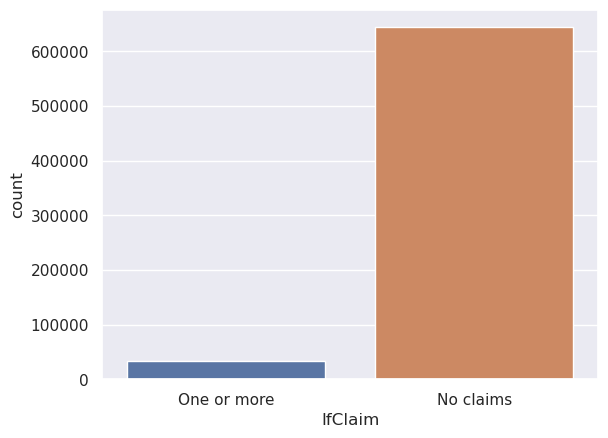

In [28]:
sns.countplot(data =df2, x='IfClaim')
pass

* W zbiorze przeważają kierowcy bezszkodowi. 

In [29]:
categorical_columns = [column for column in df2.columns if df2[column].dtype in ["object"] and column != 'RegCode']
categorical_columns

['Area', 'VehBrand', 'VehGas', 'RegName', 'IfClaim']

In [30]:
df2.head()

,ClaimNb,Exposure,Area,VehPower,VehAge,DrivAge,BonusMalus,VehBrand,VehGas,Density,RegCode,RegName,Freq,IfClaim
0,1.0,0.10,D,5.0,0.0,55.0,50.0,B12,Regular,1217.0,84,Auvergne-Rhône-Alpes,10.000000,One or more
1,1.0,0.77,D,5.0,0.0,55.0,50.0,B12,Regular,1217.0,84,Auvergne-Rhône-Alpes,1.298701,One or more
2,1.0,0.69,A,6.0,0.0,60.0,51.0,B12,Diesel,12.0,84,Auvergne-Rhône-Alpes,1.449275,One or more
3,1.0,0.16,A,6.0,0.0,60.0,51.0,B12,Diesel,12.0,84,Auvergne-Rhône-Alpes,6.250000,One or more
4,2.0,0.75,C,5.0,0.0,33.0,66.0,B12,Regular,151.0,84,Auvergne-Rhône-Alpes,2.666667,One or more


# 2. Analiza danych

### Rozkład i zakres zmiennych. Korelacje pomiędzy zmiennymi

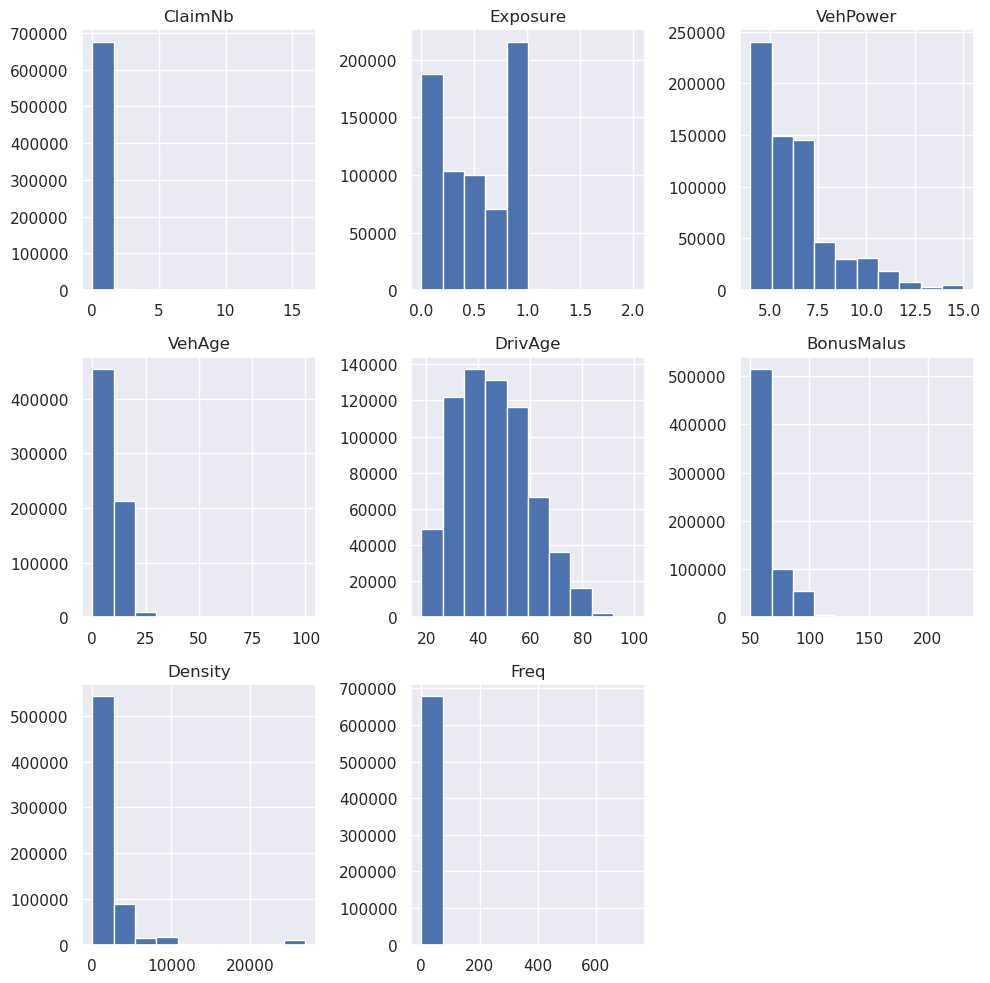

In [31]:
df2.hist(figsize=(10,10)) 
plt.tight_layout()
plt.show()

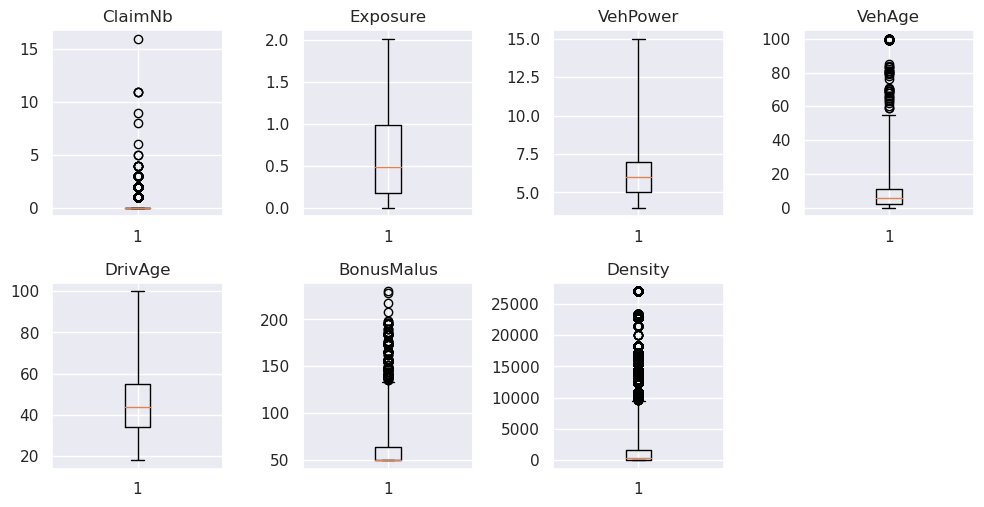

In [32]:
i = 1
plt.figure(figsize=(10,10))
for var in numerical_columns:
   plt.subplot(4,4,i)
   plt.boxplot(df2[var],whis=5)
   plt.title(var)
   i+=1
plt.tight_layout()
plt.show()

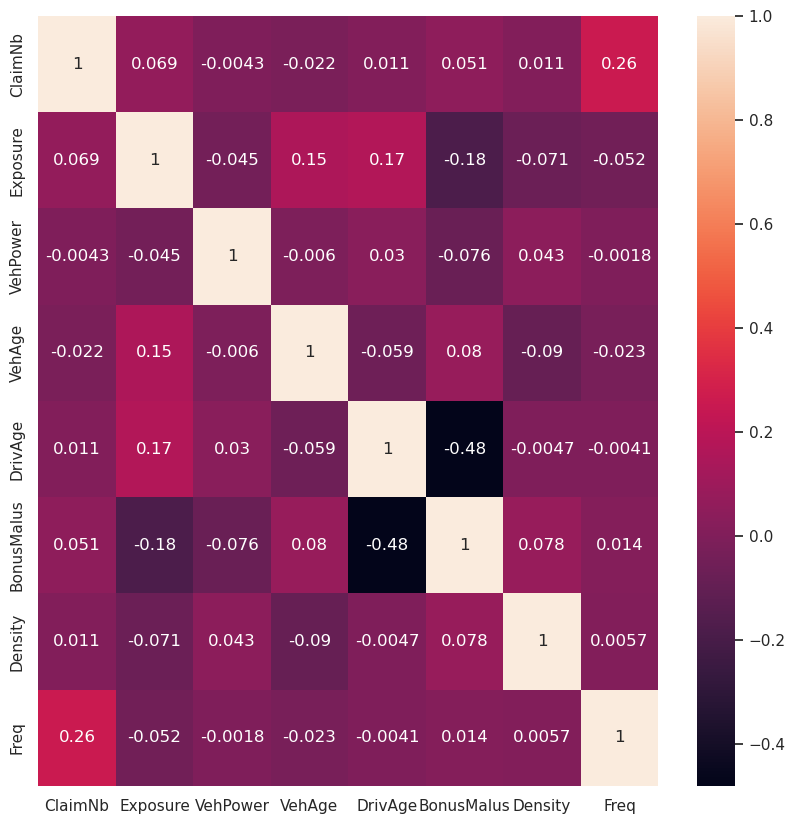

In [33]:
corr_matrix = df2.corr()
plt.figure(figsize = (10,10))
ax = sns.heatmap(corr_matrix, annot=True)
plt.show()

<Figure size 700x700 with 0 Axes>

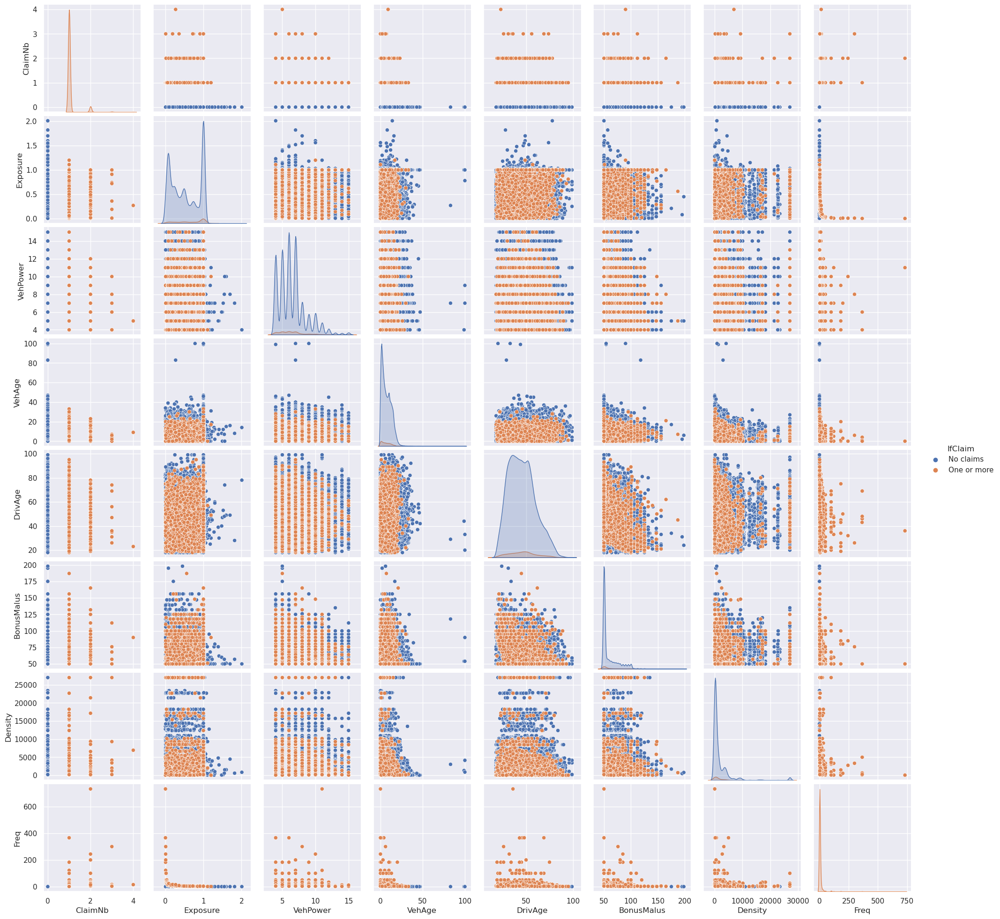

In [46]:
# Wykres poglądowy wykonany dla próbki zbioru
plt.figure(figsize=(7,7))
df2_sample = df2.groupby('ClaimNb', group_keys=False).apply(lambda x: x.sample(frac=0.1))
sns.pairplot(df2_sample, hue='IfClaim')
pass

In [34]:
df2.describe().T

,count,mean,std,min,25%,50%,75%,max
ClaimNb,677997.0,0.053239,0.240104,0.000000,0.00,0.00,0.00,16.00
Exposure,677997.0,0.528748,0.364442,0.002732,0.18,0.49,0.99,2.01
VehPower,677997.0,6.454642,2.050916,4.000000,5.00,6.00,7.00,15.00
VehAge,677997.0,7.044303,5.666241,0.000000,2.00,6.00,11.00,100.00
DrivAge,677997.0,45.499051,14.137518,18.000000,34.00,44.00,55.00,100.00
BonusMalus,677997.0,59.761530,15.636710,50.000000,50.00,50.00,64.00,230.00
Density,677997.0,1792.443110,3958.682835,1.000000,92.00,393.00,1658.00,27000.00
Freq,677997.0,0.263797,4.592352,0.000000,0.00,0.00,0.00,732.00


### Wnioski
* Zmienne znajdują się na różnych skalach - konieczne będzie przeskalowanie danych przed zbudowaniem modeli.
* Rozkład większości zmiennych jest skośny - możliwe, że potrzebna będzie transformacja zmiennych.
* Do modelowania wartości targetu (Freq) nie można zastosować regresji liniowej (nie jest spełniony warunek rozkładu normalnego zmiennej zależnej).
* Zakresy wartości są prawdopodobne - możemy założyć, że w zbiorze nie ma wartości odbiegających wynikających z błędów grubych (pomyłki przy tworzeniu zbioru danych).
* Istnieją stosunkowo silne korelacje liniowe pomiędzy zmiennymi (np. f-cja BonusMalus-wiek kierowcy) co również wyklucza zastosowanie regresji liniowej do przewidywania wartości częstości szkód (Freq). 
* Co istotne, z tabeli wynika, że poza zmienną ClaimNb (której 'pochodną' jest zmienna targetu Freq) pomiędzy wartościami cech a targetu występuje bardzo mała korelacja liniowa (Pearsona) - jest to dodatkowy dowód na to, że mamy tu do czynienia z rozkładem inny niż normalny - brak liniowej zależności target-zmienne (y(x)). Potwierdzone to jest dodatkowo wykresem zależności zmiennych numerycznych od targetu.

## Analiza zmiennych kategorycznych i ich wpływu na rozkład zmiennych numerycznych

In [35]:
# Funcja budujący dashboard do analizy danych w JupyterNotebook
def data_analysis(df:pd.DataFrame):

    categorical_menu = widgets.Dropdown(options=categorical_columns,
                                        value=categorical_columns[0],
                                        description="Category 1: ")

    opt1_values = sorted([str(x) for x in df[categorical_menu.value].unique()])
    opt1_values.append('all') 

    opt1 = widgets.Dropdown(options=opt1_values,
                            value='all',
                            description="Options: ")

    categorical_menu_hue = widgets.Dropdown(options=categorical_columns,
                                            value=categorical_columns[0],
                                            description="Category 2: ")

    opt2_values = sorted([str(x) for x in df[categorical_menu_hue.value].unique()])
    opt2_values.append('all')

    opt2 = widgets.Dropdown(options=opt2_values,
                            value='all',
                            description="Options: ")
    
    prop_options = [x for x in numerical_columns]
    prop_options.append(target)
    property_distribution = widgets.Dropdown(options=prop_options,
                                            value=prop_options[-1],
                                            description="Variable: ")

    box1 = widgets.VBox([categorical_menu,opt1])
    box2 = widgets.VBox([categorical_menu_hue,opt2])
    category_box = widgets.HBox([box1,box2,property_distribution])

    out = widgets.Output()
    out2 = widgets.Output()
    cat_box_out = widgets.HBox([out,out2])


    def update_dropdown1(change):

        opt1_options = sorted([str(x) for x in df[categorical_menu.value].unique()])
        opt1_options.append('all')
        opt1.options = opt1_options
        opt1.value = 'all'

    def update_dropdown2(change):

        opt2_options = sorted([str(x) for x in df[categorical_menu_hue.value].unique()])
        opt2_options.append('all')
        opt2.options = opt2_options
        opt2.value = 'all'

    
    def common_filtering(column,hue,option1,option2,property):

        column = categorical_menu.value
        hue = categorical_menu_hue.value
        option1 = opt1.value
        option2 = opt2.value
        property = property_distribution.value

        if option1 != 'all':
                filtered_data = df[df[column].astype('string')==option1]
        else:
                filtered_data = df

        
        with out:
            out.clear_output(wait=True)
            if option2 == 'all':
                plt.figure(figsize=(8,5))
                if column==hue:
                    p = sns.countplot(data=filtered_data, x=column, order = filtered_data[column].value_counts().index)
                else:
                    p = sns.countplot(data=filtered_data, x=column, hue=hue,order = filtered_data[column].value_counts().index)

                if len(filtered_data[column].unique()) > 12:
                    p.tick_params(axis='x', rotation=90)
                plt.title(f'Data distribution for {column} variable')
                plt.ylabel("Number of policies")
                plt.show()
                
            else:
                try:
                    plt.figure(figsize=(8,5))
                    p = sns.countplot(data=filtered_data[filtered_data[hue].astype('string')==option2], x=column)
                    if len(filtered_data[column].unique()) > 12:
                        p.tick_params(axis='x', rotation=90)
                    plt.title(f'Data distribution for {column} variable')
                    plt.ylabel("Number of policies")
                    plt.show()
                except ValueError:
                    print("No samples meeting the selected parameters!")
            
            
        with out2:
            out2.clear_output(wait=True)
            if option2 == 'all':
                fig,axes = plt.subplots(1,2,figsize=(15,5))
                sns.boxplot(data=filtered_data, y = property, x='IfClaim', showmeans=True,meanprops={"markeredgecolor": "yellow"}, ax=axes[0])
                axes[0].set_title(f'Distribution of {property} variable for selected {column}')
                sns.pointplot(data=filtered_data, y = property, dodge=True,x=column,ax=axes[1])
                axes[1].set_title(f'Distribution of mean {property} variable for selected {column}')
                if len(filtered_data[column].unique()) > 12:
                    plt.tick_params(axis='x', rotation=90)
                plt.show()

            else:
                try:
                    fig,axes = plt.subplots(1,2,figsize=(15,5))
                    sns.boxplot(data=filtered_data[filtered_data[hue].astype('string')==option2], y = property, x='IfClaim',showmeans=True,meanprops={"markeredgecolor": "yellow"},ax=axes[0])
                    axes[0].set_title(f'Distribution of {property} variable for selected {column}')
                    sns.pointplot(data=filtered_data[filtered_data[hue].astype('string')==option2], y = property, dodge=True,x=column,ax=axes[1])
                    axes[1].set_title(f'Distribution of mean {property} variable for selected {column}')
                    if len(filtered_data[column].unique()) > 12:
                        plt.tick_params(axis='x', rotation=90)
                    plt.show()

                except ValueError:
                    print("No samples meeting the selected parameters!")


    def categorical_menu_eventhandler(change):
        update_dropdown1(change.new)
        common_filtering(change.new, categorical_menu_hue.value,opt1.value,opt2.value,property_distribution.value)
        

    def categorical_menu_hue_eventhandler(change):
        update_dropdown2(change.new)
        common_filtering(categorical_menu.value, change.new,opt1.value,opt2.value,property_distribution.value)

    def opt1_eventhandler(change):
        common_filtering(categorical_menu.value, categorical_menu_hue.value,change.new,opt2.value, property_distribution.value)

    def opt2_eventhandler(change):
        common_filtering(categorical_menu.value, categorical_menu_hue.value,opt1.value,change.new,property_distribution.value)

    def property_eventhandler(change):
        common_filtering(categorical_menu.value, categorical_menu_hue.value,opt1.value,opt2.value,change.new)

    categorical_menu.observe(categorical_menu_eventhandler, names='value')
    categorical_menu_hue.observe(categorical_menu_hue_eventhandler, names='value')
    opt1.observe(opt1_eventhandler, names='value')
    opt2.observe(opt2_eventhandler, names='value')
    property_distribution.observe(property_eventhandler, names='value')

    display(category_box,cat_box_out)

## Jak zmienne kategoryczne wpływają na rozkład wybranych zmiennych numerycznych i targetu (Freq)?
Dashboard pomagający w analizie zależności pomiędzy zmiennymi. Najważniejsze wnioski zostały dodatkowo przedstawione w formie tabel i macierzy korelacji wyjaśniających te relacje.


## Analiza w formie graficznej

In [36]:
data_analysis(df2)

## Analiza tabelaryczna

### W którym regionie częstość zgłaszanych szkód komunikacyjnych jest największa (i dlaczego)?

In [37]:
df2.groupby('RegName').mean().sort_values(by='Freq',ascending=False)

,ClaimNb,Exposure,VehPower,VehAge,DrivAge,BonusMalus,Density,Freq
RegName,,,,,,,,
Île-de-France,0.056985,0.432850,6.722754,4.801462,44.624344,62.521522,8085.716263,0.411678
Corse,0.054694,0.391040,6.713020,3.869353,45.903897,61.106732,534.260407,0.379998
Bourgogne-Franche-Comté,0.048062,0.472954,6.451345,6.042647,44.590878,60.914029,597.462599,0.331357
Occitanie,0.042196,0.410907,6.453347,5.777746,45.768775,59.628456,767.863120,0.289089
Provence-Alpes-Côte d'Azur,0.049249,0.451245,6.537006,6.004413,47.029025,59.034181,1607.810054,0.278999
Auvergne-Rhône-Alpes,0.057976,0.529433,6.593434,7.048191,44.848840,60.246254,2124.838744,0.268010
Hauts-de-France,0.045778,0.427234,6.277814,6.107571,41.120922,63.369313,1429.829672,0.266500
Grand Est,0.049627,0.577993,6.296223,6.241107,47.398551,58.056599,1044.868412,0.262524
Nouvelle-Aquitaine,0.046851,0.507473,6.441645,7.144394,45.704987,59.412705,874.747525,0.233678


#### Wnioski
* Z analizy wynika, że dwa regiony o największej częstości wypadków to Île-de-France (Paryż) i Corse. Co ciekawe są to odpowiednio regiony o największej i prawie najmniejszej gęstości zaludnienia, co wyjaśnia dużą ilość kolizji tylko dla pierwszego z nich.
* Jak wynika z analizy Île-de-France to głównie obszary zaklasyfikowane jako 'E' i 'F', natomiast w przypadku Korsyi udzial tych obszarów jest najmniejszy.
* Wartości średnich zmiennych dla tyh dwóch regionów są zbliżone - największa różnica występuje jednak dla średniego wieku auta. Co ciekawe, młodszy wiek auta przekłada sie na większą częstość wypadków.
* Trend ten obserwowany jest dla wszytkich regionów:

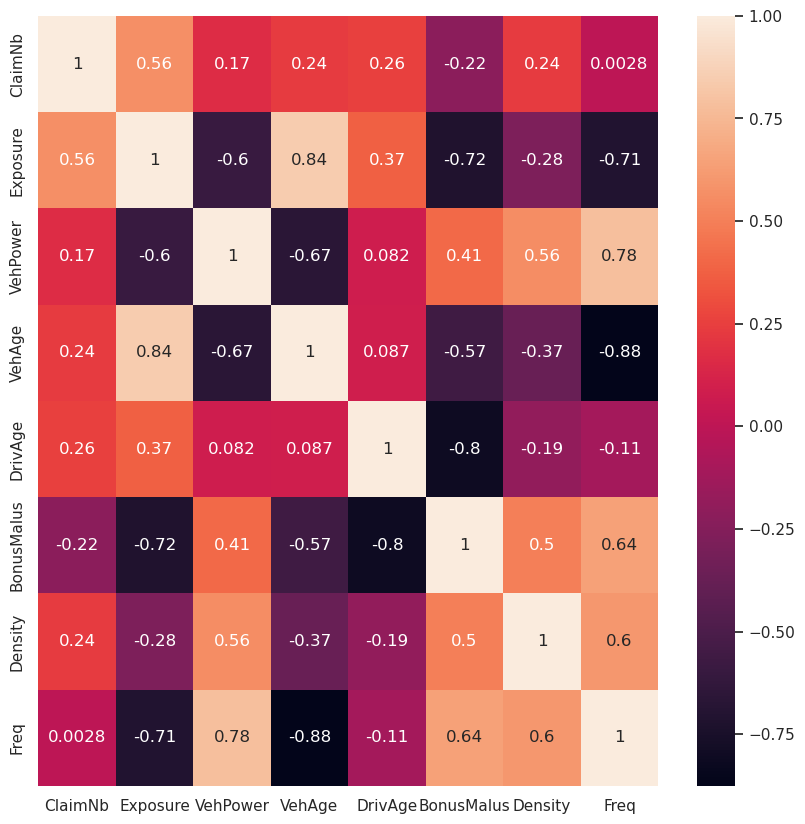

In [38]:
corr_matrix = df2.groupby('RegName').mean().corr()
plt.figure(figsize = (10,10))
ax = sns.heatmap(corr_matrix, annot=True)
plt.show()

* Poza wspomnianymi zależnościami największy wpływ na częstość wypadków w danym regionie mają moc auta (dodatnia korelacja) oraz wartość f-cji BonusMalus, a także (co oczywiste) okres trwania polisy.

#### Wartości ClaimNb  i Exposure dla poszczególnych regionów

In [39]:
reg_analysis = df2.groupby('RegName').agg({
                        'ClaimNb':'sum',
                        'Exposure':'median', 
                        'Freq':'mean', 
                         }).reset_index()

reg_analysis.columns = reg_analysis.columns.get_level_values(0)
reg_analysis.sort_values(by='Freq',ascending=False)

,RegName,ClaimNb,Exposure,Freq
12,Île-de-France,3977.0,0.38,0.411678
4,Corse,247.0,0.35,0.379998
1,Bourgogne-Franche-Comté,568.0,0.42,0.331357
9,Occitanie,2234.0,0.34,0.289089
11,Provence-Alpes-Côte d'Azur,3906.0,0.41,0.278999
0,Auvergne-Rhône-Alpes,5220.0,0.49,0.268010
6,Hauts-de-France,1615.0,0.35,0.266500
5,Grand Est,904.0,0.58,0.262524
8,Nouvelle-Aquitaine,2574.0,0.47,0.233678
10,Pays de la Loire,2009.0,0.55,0.230857


### Kategoria miejsca zamieszkania a częstość zgłaszanych szkód

In [40]:
df2.groupby('Area').mean().sort_values(by='Freq',ascending=False)

,ClaimNb,Exposure,VehPower,VehAge,DrivAge,BonusMalus,Density,Freq
Area,,,,,,,,
F,0.062994,0.452781,7.020441,4.604656,46.554584,63.368274,22014.560878,0.406361
E,0.056888,0.465265,6.422217,6.444504,44.437513,62.475526,4380.309797,0.291314
D,0.055589,0.508722,6.408232,6.935189,44.966536,60.954702,1075.896092,0.288497
C,0.051461,0.544342,6.440083,7.077107,45.780680,58.616172,248.935640,0.243807
B,0.050334,0.570016,6.451946,7.439753,45.803554,57.850045,72.582207,0.243800
A,0.048705,0.596096,6.496215,8.068608,46.753138,57.319096,27.503343,0.218260


#### Wnioski
* Spodziewanie obszary o największej gęstości zaludniania (F) cechują się największą wartością Freq, a malejący trend jest zgodny z klasyfikacja A-F ustanowiona na podstawie zmniejszającej się gęstości zaludnienia w danym obszarze (Density).  
* Co ciekawe, średni wiek auta również wzrasta wraz ze spadkiem gęstości zaludnienia aż do obszarów wiejskich (A), podobnie jak czas trwania polisy (Exposure).

### Marka samochodu a częstość zgłaszanych szkód

In [42]:
res1=df2.groupby('VehBrand').size().reset_index(name='counts')
res2=df2.groupby('VehBrand').mean()
res_VehBrand = pd.merge(res1, res2, on="VehBrand").sort_values(by='Freq',ascending=False)
res_VehBrand

,VehBrand,counts,ClaimNb,Exposure,VehPower,VehAge,DrivAge,BonusMalus,Density,Freq
3,B12,166018,0.053338,0.390355,6.856232,2.593978,47.456661,58.811587,2693.410233,0.491560
7,B3,53394,0.052777,0.535489,6.284189,7.509215,41.191051,62.156272,1722.557160,0.235089
10,B6,28548,0.051212,0.549424,5.971276,7.673848,43.729053,60.886717,1687.217458,0.201189
9,B5,34751,0.058128,0.575251,6.076487,8.539236,44.276366,61.008230,1482.888982,0.198505
1,B10,17707,0.048455,0.536286,8.995200,8.571469,47.393460,56.981137,1803.041283,0.196480
4,B13,12177,0.053297,0.556051,7.684405,8.294572,45.364047,58.561797,1907.451425,0.195472
8,B4,25179,0.052107,0.547103,5.942134,7.244926,42.460543,61.593431,1594.965368,0.192475
0,B1,162735,0.053320,0.585922,6.169097,8.982782,45.382813,59.668486,1449.599293,0.187835
6,B2,159856,0.053536,0.593416,6.039235,8.635547,46.058922,59.719985,1318.949961,0.175142
2,B11,13585,0.053073,0.507016,8.911299,8.023261,43.431432,59.746191,1895.517851,0.160176


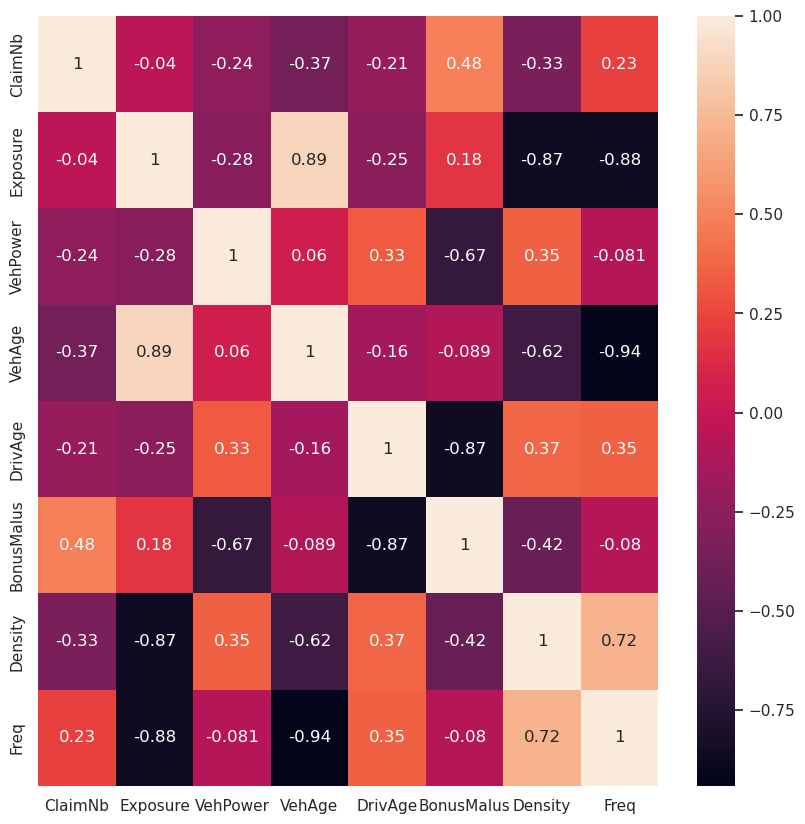

In [62]:
corr_matrix_2 = df2.groupby('VehBrand').mean().corr()
plt.figure(figsize = (10,10))
ax = sns.heatmap(corr_matrix_2 , annot=True)
plt.show()

#### Wnioski
* Co ciekawe, chociaż 3 najczęściej rejestrowane marki samochodów to grupy B1, B2 i B12 (a zatem potencjalnie najczęściej biorące udział w zgłoszonych zdarzeniach komunikacyjnych), tylko jedna odznacza się ponad dwukrotnie wyższa niż dla pozostałych średnią częstością zgłoszeń: B12.
* Jest to marka, w której średni wiek zarejestrowanego samochodu jest też najniższy, a wartość ta jest kilkukrotnie niższa niż dla pozostałych. Jest ona też wybierana przez starszych kierowców mieszkających w ośrodkach o dużym zagęszczeniu ludności. Średni okres trwnia polisy również jest wyraźnie krótszy niż dla innych marek.
* Macierz korelacji również potwierdza, że w przypaku podziału na markę samoachodu największy wpływ na wartośc częstości szkód ma wiek samochodu, okres trwania polisy oraz gęstość zaludnienia.

### Rodzaj silnika (Regular/Diesel) a częstość zgłaszanych szkód

In [43]:
df2.groupby('VehGas').mean()

,ClaimNb,Exposure,VehPower,VehAge,DrivAge,BonusMalus,Density,Freq
VehGas,,,,,,,,
Diesel,0.050116,0.513825,6.578462,6.308960,44.464876,59.260150,1392.375775,0.209463
Regular,0.056238,0.543077,6.335742,7.750426,46.492133,60.242987,2176.613936,0.315973


#### Wnioski
* Pomimo zbliżonej ilości polis ubezpieczeniowych na samochody Diesla i benzynowe, istnieje pomiędzy nimi istotna różnica i średnio częsciej w zgłoszonych zdarzeniach komunikacyjnych biorą udział samochody benzynowe. 
* Są to średnio samochody starsze prowadzone przez starszych kierowców.

### Kierowcy bezszkodowi - co ich wyróżnia?

In [44]:
df2.groupby('IfClaim').mean()

,ClaimNb,Exposure,VehPower,VehAge,DrivAge,BonusMalus,Density,Freq
IfClaim,,,,,,,,
No claims,0.000000,0.522731,6.456491,7.072929,45.459721,59.585024,1783.227165,0.000000
One or more,1.059964,0.642526,6.419686,6.502995,46.242761,63.099166,1966.711723,5.252062


#### Wnioski
  Kierowcy bezszkodowi są  średnio:
  * młodsi, 
  * mieszkają w ośrodkach o mniejszym zagęszczeniu ludności,
  * posiadają polisy ubezpieczeniowe krócej,
  * posiadają starsze samochody o nieznacznie większej mocy.

## Analiza wybranych zmiennych numerycznych

In [45]:
def distribution_plot(df, var:str):
    plt.subplots(nrows=1, ncols=2, figsize=(10, 5))
    plt.subplot(1, 2, 1)
    sns.histplot(df, x=var)
    plt.subplot(1, 2, 2)
    sns.boxplot(y=var, data=df, showmeans=True)
    plt.suptitle(f"{var} variable distribution")
    plt.show()

In [47]:
def numeric_variable_plot(df:pd.DataFrame, var:str, categories:list):

    i = 0
    j=0

    fig, axes = plt.subplots(2,3,figsize=(20,15))
    plt.suptitle(f"Mean value of {var} for categorical features groups")
    for cat in categories:
        if i>2:
            j=1
            i=0
        sns.pointplot(data=df,y = var, x=cat, dodge=True,ax=axes[j,i])
        axes[j,i].set_title(f"Mean value of {var} for {cat} categories")
        if len(df[cat].unique()) > 12:
            axes[j,i].tick_params(axis='x', rotation=90)
        i += 1
    plt.tight_layout()
    plt.show()

### Polisy ze znaczącą liczbą zgłoszeń - ClaimNb > 3

In [48]:
cl_1 = df2[df2["ClaimNb"]>1]
cl_1.describe()

,ClaimNb,Exposure,VehPower,VehAge,DrivAge,BonusMalus,Density,Freq
count,1882.000000,1882.000000,1882.000000,1882.000000,1882.000000,1882.000000,1882.000000,1882.000000
mean,2.085016,0.644330,6.428799,6.104145,45.758236,67.553135,2297.454835,9.577869
std,0.589829,0.327500,2.027844,5.231361,15.533281,22.663420,4694.012859,37.046100
min,2.000000,0.002732,4.000000,0.000000,18.000000,50.000000,4.000000,1.680672
25%,2.000000,0.370000,5.000000,2.000000,34.000000,50.000000,132.000000,2.000000
50%,2.000000,0.710000,6.000000,5.000000,45.000000,57.000000,634.000000,2.941176
75%,2.000000,1.000000,7.000000,10.000000,56.000000,80.000000,2674.000000,5.555556
max,16.000000,1.190000,15.000000,37.000000,91.000000,196.000000,27000.000000,732.000000


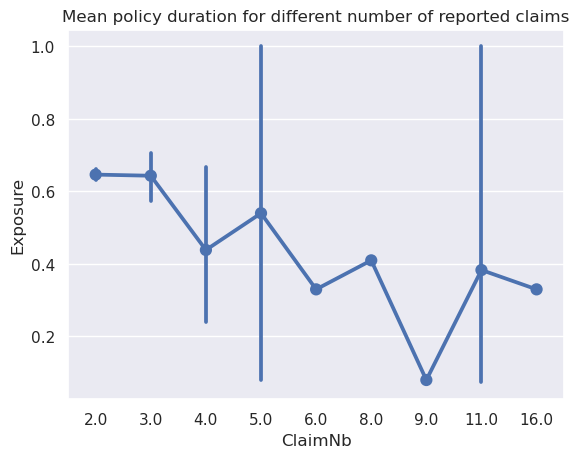

In [36]:
sns.pointplot(data=cl_1, y = 'Exposure', dodge=True,x='ClaimNb')
plt.title(f'Mean policy duration for different number of reported claims')
pass

#### Wnioski
* Jak wykazała wcześniejsza analiza, większość przypadków w zbiorze stanowią polisy, dla których nie została zgłoszona żadna szkoda.
* Spośród tych, w których pojawiły sie szkody komunikacyjne, znakomitą większość stanowią te z tylko jednym takim zdarzeniem.
* Z przedstawionych na wykresie średnich czasów trwania polisy od ilości zgłoszonych zdarzeń wynika, że powyżej wartości 3 obserwujemy anomalne zachowanie (im krótszy średni okres polisy, tym więcej zgłoszonych zdarzeń).Mogą to być przypadki samochodów oferowanych na wynajem. 
* Warto w dalszej części, na etapie tworzenia modelu ustalić próg wartości, powyżej których dane zostaną odrzucone ze zbioru (np. 4).

### Okres trwania polisy - zmienna 'Exposure'

#### Procent polis zawartych na okres 1 roku i więcej

In [34]:
df2["Exposure"].describe()

count    677997.000000
mean          0.528748
std           0.364442
min           0.002732
25%           0.180000
50%           0.490000
75%           0.990000
max           2.010000
Name: Exposure, dtype: float64

In [35]:
df2['ExposureGrp'] = df2['Exposure'].apply(lambda x: 'Full Year' if x == 1 else 'Over Year' if x>1 else 'not Full Year')
df2[['Exposure', 'ExposureGrp']].groupby('ExposureGrp').count().apply(lambda x: 100 * x / float(x.sum()))

,Exposure
ExposureGrp,
Full Year,24.796570
Over Year,0.180532
not Full Year,75.022898


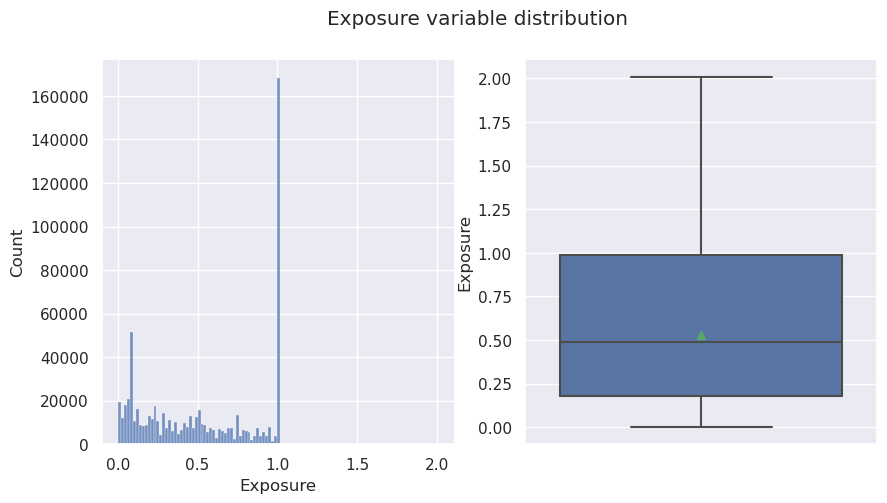

In [49]:
distribution_plot(df2, var="Exposure")

In [37]:
categories = [x for x in categorical_columns]
categories.append("ClaimNb")

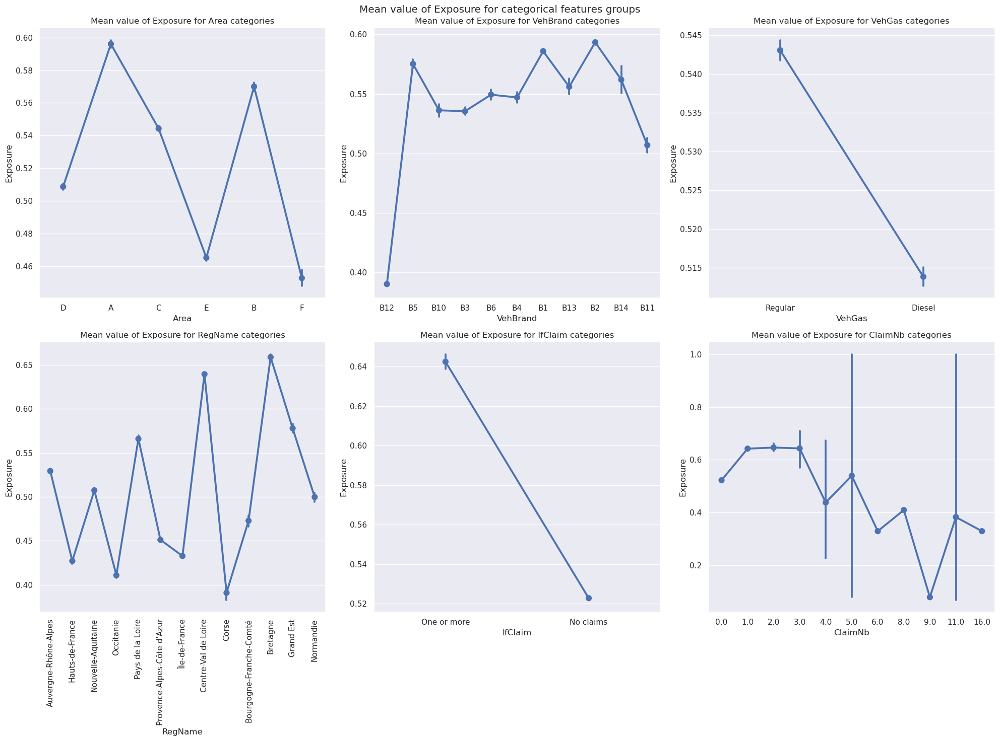

In [38]:
numeric_variable_plot(df2,"Exposure",categories)

#### Wnioski
* Minimalny okres polisy wynosi 0,002732 czyli 1 dzień (0,002732 * 365), maksymalny - 2 lata, a średni okres trwania polisy to zaledwie pół roku.
* Jedynie 25% polis trwa rok a zaledwie 0.25% dłużej niż rok (należałoby zastanowić się nad odcięciem wartości powyżej 1 roku).
* Na obszarach o wysokiej gęstości zaludnienia wyraźnie spada średni okres trwania polisy.
* Pozostałe zależności zostały omówione przy analizie zmiennych kategorycznych.

# 3. Przygotowanie danych do modelowania (preprocessing)

In [50]:
df2.head()

,ClaimNb,Exposure,Area,VehPower,VehAge,DrivAge,BonusMalus,VehBrand,VehGas,Density,RegCode,RegName,Freq,IfClaim
0,1.0,0.10,D,5.0,0.0,55.0,50.0,B12,Regular,1217.0,84,Auvergne-Rhône-Alpes,10.000000,One or more
1,1.0,0.77,D,5.0,0.0,55.0,50.0,B12,Regular,1217.0,84,Auvergne-Rhône-Alpes,1.298701,One or more
2,1.0,0.69,A,6.0,0.0,60.0,51.0,B12,Diesel,12.0,84,Auvergne-Rhône-Alpes,1.449275,One or more
3,1.0,0.16,A,6.0,0.0,60.0,51.0,B12,Diesel,12.0,84,Auvergne-Rhône-Alpes,6.250000,One or more
4,2.0,0.75,C,5.0,0.0,33.0,66.0,B12,Regular,151.0,84,Auvergne-Rhône-Alpes,2.666667,One or more


### Usunięcie zbędnych kolumn

In [51]:
df_ml = df2.copy()
df_ml.drop(['RegCode'], axis=1, inplace=True)
df_ml.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 677997 entries, 0 to 677996
Data columns (total 13 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   ClaimNb     677997 non-null  float64
 1   Exposure    677997 non-null  float64
 2   Area        677997 non-null  object 
 3   VehPower    677997 non-null  float64
 4   VehAge      677997 non-null  float64
 5   DrivAge     677997 non-null  float64
 6   BonusMalus  677997 non-null  float64
 7   VehBrand    677997 non-null  object 
 8   VehGas      677997 non-null  object 
 9   Density     677997 non-null  float64
 10  RegName     677997 non-null  object 
 11  Freq        677997 non-null  float64
 12  IfClaim     677997 non-null  object 
dtypes: float64(8), object(5)
memory usage: 72.4+ MB


### Usunięcie outlierów

* Korzystając z rozkładu danych dla wszystkich zmiennych z początku analizy odrzucam wiersze z wyraźnymi wartościami odbiegającymi:

    * ClaimNb < 5;
    * Exposure <= 1;
    * BonusMalus <1 25;
    * VehAge < 25;
    * DrivAge < 90.

In [52]:
df_ml.describe()

,ClaimNb,Exposure,VehPower,VehAge,DrivAge,BonusMalus,Density,Freq
count,677997.000000,677997.000000,677997.000000,677997.000000,677997.000000,677997.00000,677997.000000,677997.000000
mean,0.053239,0.528748,6.454642,7.044303,45.499051,59.76153,1792.443110,0.263797
std,0.240104,0.364442,2.050916,5.666241,14.137518,15.63671,3958.682835,4.592352
min,0.000000,0.002732,4.000000,0.000000,18.000000,50.00000,1.000000,0.000000
25%,0.000000,0.180000,5.000000,2.000000,34.000000,50.00000,92.000000,0.000000
50%,0.000000,0.490000,6.000000,6.000000,44.000000,50.00000,393.000000,0.000000
75%,0.000000,0.990000,7.000000,11.000000,55.000000,64.00000,1658.000000,0.000000
max,16.000000,2.010000,15.000000,100.000000,100.000000,230.00000,27000.000000,732.000000


In [53]:
df_ml = df_ml.query("ClaimNb < 5 & Exposure <= 1 & BonusMalus < 126 & VehAge < 25 & DrivAge < 91")
# df_ml["Density"]=df_ml["Density"].apply(lambda x: np.log(x))

In [42]:
df_ml.describe()

,ClaimNb,Exposure,VehPower,VehAge,DrivAge,BonusMalus,Density,Freq
count,672465.000000,672465.000000,672465.000000,672465.000000,672465.000000,672465.000000,672465.000000,672465.000000
mean,0.053039,0.527091,6.449075,6.926384,45.466292,59.681771,1793.637542,0.263800
std,0.237187,0.363750,2.045509,5.378388,14.082403,15.371593,3958.868129,4.593503
min,0.000000,0.002732,4.000000,0.000000,18.000000,50.000000,1.000000,0.000000
25%,0.000000,0.170000,5.000000,2.000000,34.000000,50.000000,92.000000,0.000000
50%,0.000000,0.490000,6.000000,6.000000,44.000000,50.000000,393.000000,0.000000
75%,0.000000,0.990000,7.000000,11.000000,55.000000,64.000000,1658.000000,0.000000
max,4.000000,1.000000,15.000000,24.000000,90.000000,125.000000,27000.000000,732.000000


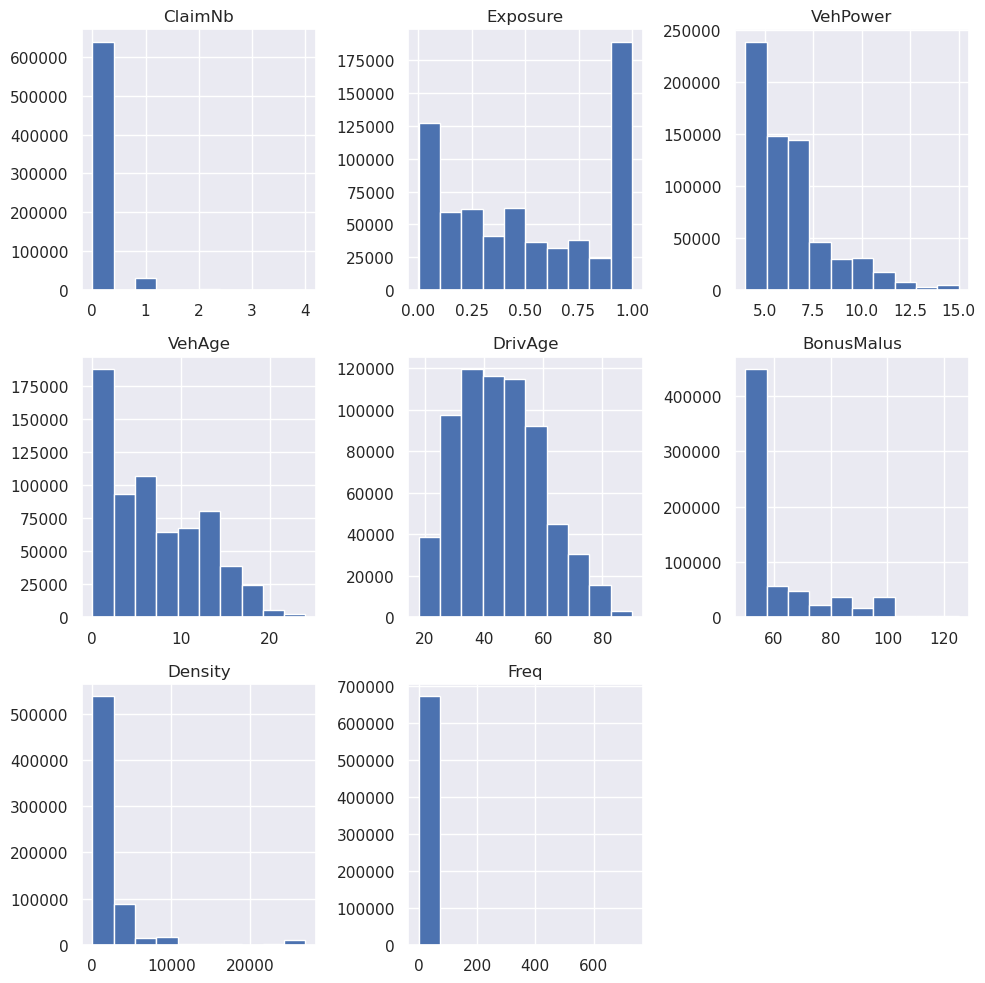

In [54]:
df_ml.hist(figsize=(10,10)) 
plt.tight_layout()
plt.show()

### Skalowanie danych (opcjonalnie, test)

In [55]:
scaling_models = {
'standard_scaler' : StandardScaler(),
'min_max_scaler' : MinMaxScaler(),
'robust_scaler' : RobustScaler(),
'quantile_transformer_normal' : QuantileTransformer(output_distribution='normal'),
'power_transformer_YeoJohnson' : PowerTransformer(method='yeo-johnson'),}

In [56]:
def scale_dataset (df:pd.DataFrame,scalers:list): 
    
    scaled_datasets = {}
    scaled_datasets['unscaled'] = df
    for scaler in scalers:
        values = df.values
        names = df.columns
        dataframe_name = str('df_' + scaler)
        model = scaling_models[scaler]
        values_scaled = model.fit_transform(values)
        scaled_df = pd.DataFrame(values_scaled)
        scaled_df.columns = names
        scaled_datasets[dataframe_name] = pd.DataFrame(scaled_df)

    return scaled_datasets

In [57]:
def plot_scaled_dataframe(scaled_datasets):
    
    n= widgets.Dropdown(options=scaled_datasets.keys(),
                        value = 'unscaled',
                        description="Select dataframe: ")

    def draw_plot(dataframe):
        
        scaled_datasets[dataframe].hist(figsize=(10,10)) 
        plt.tight_layout()
        plt.show()

    out = widgets.interactive_output(draw_plot,{'dataframe':n})

    display(n,out)

In [58]:
scaled_datasets= scale_dataset(df_ml[numerical_columns],list(scaling_models.keys()))

In [59]:
plot_scaled_dataframe(scaled_datasets)

Dropdown(description='Select dataframe: ', options=('unscaled', 'df_standard_scaler', 'df_min_max_scaler', 'df…

Output()

### Wnioski
* W przypadku zastosowania modeli ML/DL można rozważyć zastosowania MinMaxScalera() (nie zmienia rozkładu danych, który wyraźnie nie jest normalny, a jedynie skalę danych)

### Transformacja danych

In [66]:
glm_model_preprocessor = ColumnTransformer(
                [("log_scaled_numeric", FunctionTransformer(np.log, validate=False), ["Density"]),
                ("passthrough_numeric", "passthrough", ["BonusMalus"]),
                ("binned_numeric", KBinsDiscretizer(n_bins=10, subsample=int(2e5), random_state=0), ["VehAge", "DrivAge"],),
                ("onehot_categorical",OneHotEncoder(),["VehBrand", "VehPower", "VehGas", "RegName", "Area"],),],
                remainder="drop",)

gbt_ml_model_preprocessor = ColumnTransformer(
                [("categorical", OrdinalEncoder(), ["VehBrand", "VehPower", "VehGas", "RegName", "Area"],),
                ("numeric", "passthrough", ["VehAge", "DrivAge", "BonusMalus", "Density"]),],
                remainder="drop",)

dl_model_preprocessor = ColumnTransformer(
                [("categorical", OneHotEncoder(), ["VehBrand", "VehPower", "VehGas", "RegName", "Area"],),
                ("numeric", "passthrough", ["VehAge", "DrivAge", "BonusMalus", "Density"]),],
                remainder="drop",)

* W zależności od badanego modelu (ML, DL czy GLM) zastosowana zostanie inna transfrmacja zmiennych. 

### Podział na zbiór treningowy i testowy

* Podział danych na zbiór treningowy i testowy z równomiernym rozkładem polis o różnych wartościach ClaimNb

In [61]:
def group_split_evaluate(df:pd.DataFrame,target:str, test_size:int):
    
    df['id'] = df.index+1
    splitter = GroupShuffleSplit(test_size=test_size, n_splits=2, random_state=42)
    split = splitter.split(df, groups=df['id'])
    train_inds, test_inds = next(split)
    df_train = df.iloc[train_inds]
    df_test = df.iloc[test_inds]
    df_train.drop(['id'], axis=1, inplace=True)
    df_test.drop(['id'], axis=1, inplace=True)
    df_train.reset_index(inplace=True, drop=True)
    df_test.reset_index(inplace=True, drop=True)


    train_per = len(df_train)/len(df)
    test_per = len(df_test)/len(df)
    print(f"Train: {train_per*100:.2f}%")
    print(f"Test: {test_per*100:.2f}%")
    print('-----------------------------------------')

    train_freq_mean = df_train['ClaimNb'].sum() / df_train['Exposure'].sum()
    test_freq_mean = df_test['ClaimNb'].sum() / df_test['Exposure'].sum()
    print(f"Mean Freq value (train): {train_freq_mean*100:.2f}")
    print(f"Mean Freq value (train): {test_freq_mean*100:.2f}")
    print('-----------------------------------------')
    
    train_class = df_train.groupby(by=['ClaimNb']).agg({'ClaimNb':['count']})
    test_class = df_test.groupby(by=['ClaimNb']).agg({'ClaimNb':['count']})
    print(f"Train {target} distribution:\n {train_class}\n")
    print(f"Test {target} distribution:\n {test_class}")

    return df_train, df_test

In [62]:
df_train, df_test = group_split_evaluate(df_ml, target='ClaimNb', test_size=0.2)

Train: 80.00%
Test: 20.00%
-----------------------------------------
Mean Freq value (train): 10.08
Mean Freq value (train): 9.99
-----------------------------------------
Train ClaimNb distribution:
         ClaimNb
          count
ClaimNb        
0.0      510929
1.0       25576
2.0        1397
3.0          65
4.0           5

Test ClaimNb distribution:
         ClaimNb
          count
ClaimNb        
0.0      127795
1.0        6334
2.0         346
3.0          16
4.0           2


# 4.Modelowanie

## Machine Learning

* Do modelu nie zostaja przekazane "ClaimNb" oraz "Exposure" jako zmienne (informacje, które niosą są już przekazane do modelu jako zmienna taretu Freq).
* Wartość "Exposure zostanie użyta jako waga próbek przekazanych do uczenia modelu - w oczywisty sposób długość polisy wpływa na możliwość wystąpienia zgłoszenia, a co za tym idzie częstość. 
* Do analizy ML zostały wybrane trzy proste modele nieliniowe: 'DecisionTreeRegressor', 'RandomForestRegressor' oraz 'XGBRegressor.

In [63]:
y = 'ClaimNb'
X = df_train.drop(["Freq","ClaimNb","Exposure"], axis=1).columns
weights = "Exposure"

In [55]:
X

Index(['Area', 'VehPower', 'VehAge', 'DrivAge', 'BonusMalus', 'VehBrand',
       'VehGas', 'Density', 'RegName', 'IfClaim', 'ExposureGrp'],
      dtype='object')

In [67]:
processors = {
    'DecisionTreeRegressor': gbt_ml_model_preprocessor,
    'RandomForestRegressor': gbt_ml_model_preprocessor,
    'XGBRegressor': gbt_ml_model_preprocessor,
    'PoissonRegressor':glm_model_preprocessor,
    'TweedieRegressor':glm_model_preprocessor,
    'GammaRegressor':glm_model_preprocessor}

In [68]:
models = {
    'DecisionTreeRegressor': DecisionTreeRegressor(max_depth=3, random_state=42),
    'RandomForestRegressor': RandomForestRegressor(max_depth=3,random_state=42),
    'XGBRegressor': XGBRegressor(max_depth=3, objective='reg:squarederror', random_state=42),
    'PoissonRegressor': PoissonRegressor(alpha=0.001,solver="newton-cholesky"),
    'TweedieRegressor':TweedieRegressor(alpha=0.001,power=1.2, solver="newton-cholesky")}
    # ,'GammaRegressor':GammaRegressor(alpha=0.001,solver="newton-cholesky")}

### Cross-validacja modeli ML (opcjonalnie)

In [69]:
folds = KFold(5,shuffle=True,random_state=0)

In [70]:
def cv_comparison(models,processors,X,y,cv):

    # Initiate a DataFrame for the averages and a list for all measures

    cv_metrics = pd.DataFrame()
    r2_scores = []
    rmse_scores = []
    mse_scores = []
    mae_scores = []
    mpd_scores = []


    # Loops through the models and scalers, run a CV, add the average scores to the DataFrame 
    # and the scores of all CVs to the list

    for model_name, model in models.items():
            
            
        pipe = Pipeline([('scaler', processors[model_name]), ('model', model)])
             
        r2 = np.round(cross_val_score(pipe, X, y, scoring='r2', cv=cv), 4)
        r2_scores.append(r2)
        r2_avg = round(r2.mean(),4)

        rmse = np.round(-cross_val_score(pipe, X, y, scoring='neg_root_mean_squared_error', cv=cv), 4)
        rmse_scores.append(rmse)
        rmse_avg = round(rmse.mean(),4)

        mse = np.round(-cross_val_score(pipe, X, y, scoring='neg_mean_squared_error', cv=cv), 4)
        mse_scores.append(mse)
        mse_avg = round(mse.mean(),4)

        mae = np.round(-cross_val_score(pipe, X, y, scoring='neg_mean_absolute_error', cv=cv), 4)
        mae_scores.append(mae)
        mae_avg = round(mae.mean(),4)

        mpd = np.round(cross_val_score(pipe, X, y, scoring='mean_poisson_deviance', cv=cv), 4)
        mpd_scores.append(mpd)
        mpd_avg = round(mpd.mean(),4)
                
        cv_metrics[str(model_name)] = [r2_avg, rmse_avg, mse_avg, mae_avg, mpd_avg]
            
    cv_metrics.index = ['R2', 'RMSE', 'MSE', 'MAE']
    return cv_metrics, r2_scores, rmse_scores, mse_scores, mae_scores


In [71]:
cv_metrics, r2_scores, rmse_scores, mse_scores, mae_scores = cv_comparison(models, processors, df_train[X], df_train[y],folds)

ValueError: 'mean_poisson_deviance' is not a valid scoring value. Use sklearn.metrics.get_scorer_names() to get valid options.

In [71]:
# Wyniki cross-validacji na zbiorze treningowym
cv_metrics

,DecisionTreeRegressor,RandomForestRegressor,XGBRegressor
R2,0.0062,0.0063,0.0068
RMSE,4.5683,4.5681,4.5665
MSE,21.0433,21.0415,21.0235
MAE,0.4887,0.4888,0.4905


### Ewaluacja na zbiorze testowym

In [72]:
# Przetworzone w oddzielnym pliku, przy zastosowania transformacji logarytmicznej nie działa funkcja get_names
coefficient_names = pd.read_csv("coeffients_list.csv")
coefficient_names = coefficient_names["0"].to_list()
coefficient_names 

['Density',
 'BonusMalus',
 'VehAge_0.0',
 'VehAge_1.0',
 'VehAge_2.0',
 'VehAge_3.0',
 'VehAge_4.0',
 'VehAge_5.0',
 'VehAge_6.0',
 'VehAge_7.0',
 'VehAge_8.0',
 'VehAge_9.0',
 'DrivAge_0.0',
 'DrivAge_1.0',
 'DrivAge_2.0',
 'DrivAge_3.0',
 'DrivAge_4.0',
 'DrivAge_5.0',
 'DrivAge_6.0',
 'DrivAge_7.0',
 'DrivAge_8.0',
 'DrivAge_9.0',
 'VehBrand_B1',
 'VehBrand_B10',
 'VehBrand_B11',
 'VehBrand_B12',
 'VehBrand_B13',
 'VehBrand_B14',
 'VehBrand_B2',
 'VehBrand_B3',
 'VehBrand_B4',
 'VehBrand_B5',
 'VehBrand_B6',
 'VehPower_4.0',
 'VehPower_5.0',
 'VehPower_6.0',
 'VehPower_7.0',
 'VehPower_8.0',
 'VehPower_9.0',
 'VehPower_10.0',
 'VehPower_11.0',
 'VehPower_12.0',
 'VehPower_13.0',
 'VehPower_14.0',
 'VehPower_15.0',
 'VehGas_Diesel',
 'VehGas_Regular',
 'RegName_Auvergne-Rhône-Alpes',
 'RegName_Bourgogne-Franche-Comté',
 'RegName_Bretagne',
 'RegName_Centre-Val de Loire',
 'RegName_Corse',
 'RegName_Grand Est',
 'RegName_Hauts-de-France',
 'RegName_Normandie',
 'RegName_Nouvelle-Aqui

In [74]:
# Funkcja zawiera metryki dla wszystkich badanych modeli - nie wszystkie będą użyte do porównania konkretnych modeli
fitted_models = {}
feature_importances=pd.DataFrame()
feature_coef=pd.DataFrame()
y_test_pred = pd.DataFrame()
y_train_pred = pd.DataFrame()
y = "Freq"

def test_fit_comparison(models:dict,processors:dict,df_train:pd.DataFrame,df_test:pd.DataFrame,y:str,weights=None):

    metrics = pd.DataFrame()
    for model_name, model in models.items():
        if weights is not None:    
            pipe = Pipeline([('processor', processors[model_name]), ('model', model)]).fit(df_train, df_train[y], model__sample_weight=df_train[weights])
        else:
            pipe = Pipeline([('processor', processors[model_name]), ('model', model)]).fit(df_train, df_train[y])

        fitted_models[model_name]=pipe

        y_pred_train = pipe.predict(df_train)
        y_pred_test = pipe.predict(df_test)

        if model_name not in ['PoissonRegressor','GammaRegressor','TweedieRegressor']:
            feature_names = pipe[:-1].get_feature_names_out()
            feature_names = [x.split("__")[1] for x in feature_names]
            feature_importances["feature"] = feature_names
            feature_importances[model_name]=pipe.named_steps['model'].feature_importances_
        
        else:
            feature_coef["feature"] = coefficient_names
            feature_coef[model_name]=pipe.named_steps['model'].coef_
            

        y_train_pred[str("y_pred_"+ model_name[:3])] = y_pred_train
        y_test_pred[str("y_pred_"+ model_name[:3])] = y_pred_test

        if weights is not None: 

            r2_test = np.round(r2_score(df_test[y], y_pred_test, sample_weight=df_test[weights]), 4)
            mse_test = np.round(mean_squared_error(df_test[y], y_pred_test, sample_weight=df_test[weights]), 4)
            mae_test = np.round(mean_absolute_error(df_test[y], y_pred_test, sample_weight=df_test[weights]), 4)
            r2_train = np.round(r2_score(df_train[y], y_pred_train, sample_weight=df_train[weights]), 4)
            mse_train = np.round(mean_squared_error(df_train[y], y_pred_train, sample_weight=df_train[weights]), 4)
            mae_train = np.round(mean_absolute_error(df_train[y], y_pred_train, sample_weight=df_train[weights]), 4)
    
            mask_train = y_pred_train > 0
            mask_test = y_pred_test > 0
            pos_dev_test = np.round(mean_poisson_deviance(df_test[y][mask_test],y_pred_test[mask_test],sample_weight=df_test[weights][mask_test]),4)
            pos_dev_train = np.round(mean_poisson_deviance(df_train[y][mask_train],y_pred_train[mask_train],sample_weight=df_train[weights][mask_train]),4)   
            metrics[str(model_name)] = [r2_test, mse_test, mae_test,r2_train,mse_train,mae_train, pos_dev_test,pos_dev_train]

        else:
            
            r2_test = np.round(r2_score(df_test[y], y_pred_test), 4)
            mse_test = np.round(mean_squared_error(df_test[y], y_pred_test), 4)
            mae_test = np.round(mean_absolute_error(df_test[y], y_pred_test), 4)
            r2_train = np.round(r2_score(df_train[y], y_pred_train), 4)
            mse_train = np.round(mean_squared_error(df_train[y], y_pred_train), 4)
            mae_train = np.round(mean_absolute_error(df_train[y], y_pred_train), 4)
    
            mask_train = y_pred_train > 0
            mask_test = y_pred_test > 0
            pos_dev_test = np.round(mean_poisson_deviance(df_test[y][mask_test],y_pred_test[mask_test]),4)
            pos_dev_train = np.round(mean_poisson_deviance(df_train[y][mask_train],y_pred_train[mask_train]),4)   
            metrics[str(model_name)] = [r2_test, mse_test, mae_test,r2_train,mse_train,mae_train, pos_dev_test,pos_dev_train]


    metrics.index = ['R2 (test)', 'MSE (test)', 'MAE (test)','R2 (train)', 'MSE (train)', 'MAE (train)','mean Poisson deviance (test)', 'mean Poisson deviance (train)']

    return metrics


In [75]:
metrics = test_fit_comparison(models,processors,df_train,df_test,y,weights=weights)

In [76]:
metrics

,DecisionTreeRegressor,RandomForestRegressor,XGBRegressor,PoissonRegressor,TweedieRegressor
R2 (test),0.0097,0.0099,0.0152,0.0078,0.0075
MSE (test),0.5318,0.5317,0.5289,0.5328,0.5330
MAE (test),0.1856,0.1855,0.1830,0.1860,0.1857
R2 (train),0.0104,0.0105,0.0171,0.0082,0.0080
MSE (train),0.5378,0.5377,0.5341,0.5390,0.5391
MAE (train),0.1860,0.1860,0.1833,0.1865,0.1862
mean Poisson deviance (test),0.5881,0.5880,0.5733,0.5896,0.5895
mean Poisson deviance (train),0.5928,0.5927,0.5756,0.5944,0.5944


In [86]:
df_test_pred= pd.concat([df_test,y_test_pred],axis=1)
df_test_pred.tail()

,ClaimNb,Exposure,Area,VehPower,VehAge,DrivAge,BonusMalus,VehBrand,VehGas,Density,RegName,Freq,IfClaim,ExposureGrp,y_pred_Dec,y_pred_Ran,y_pred_XGB,y_pred_Poi,y_pred_Twe
134488,0.0,0.04,C,8.0,0.0,52.0,50.0,B12,Diesel,351.0,Normandie,0.0,No claims,not Full Year,0.197697,0.188079,0.219000,0.231559,0.238533
134489,0.0,0.06,C,8.0,0.0,52.0,50.0,B12,Diesel,351.0,Normandie,0.0,No claims,not Full Year,0.197697,0.188079,0.219000,0.231559,0.238533
134490,0.0,0.08,C,13.0,0.0,64.0,50.0,B12,Regular,111.0,Normandie,0.0,No claims,not Full Year,0.572133,0.571828,0.194447,0.247074,0.248757
134491,0.0,0.04,E,5.0,2.0,25.0,100.0,B12,Regular,4982.0,Normandie,0.0,No claims,not Full Year,0.279779,0.270653,0.246016,0.274027,0.266440
134492,0.0,0.03,D,9.0,0.0,54.0,50.0,B12,Diesel,867.0,Normandie,0.0,No claims,not Full Year,0.197697,0.189125,0.416548,0.311009,0.314315


In [78]:
df_train_pred= pd.concat([df_train,y_train_pred],axis=1)
df_train_pred.head()

,ClaimNb,Exposure,Area,VehPower,VehAge,DrivAge,BonusMalus,VehBrand,VehGas,Density,RegName,Freq,IfClaim,ExposureGrp,y_pred_Dec,y_pred_Ran,y_pred_XGB,y_pred_Poi,y_pred_Twe
0,1.0,0.10,D,5.0,0.0,55.0,50.0,B12,Regular,1217.0,Auvergne-Rhône-Alpes,10.000000,One or more,not Full Year,0.572133,0.571828,0.601694,0.327558,0.319959
1,1.0,0.77,D,5.0,0.0,55.0,50.0,B12,Regular,1217.0,Auvergne-Rhône-Alpes,1.298701,One or more,not Full Year,0.572133,0.571828,0.601694,0.327558,0.319959
2,1.0,0.16,A,6.0,0.0,60.0,51.0,B12,Diesel,12.0,Auvergne-Rhône-Alpes,6.250000,One or more,not Full Year,0.197697,0.188079,0.240636,0.247660,0.248495
3,2.0,0.75,C,5.0,0.0,33.0,66.0,B12,Regular,151.0,Auvergne-Rhône-Alpes,2.666667,One or more,not Full Year,0.572133,0.571828,0.714338,0.332373,0.321775
4,1.0,0.11,C,5.0,0.0,33.0,66.0,B12,Regular,151.0,Auvergne-Rhône-Alpes,9.090909,One or more,not Full Year,0.572133,0.571828,0.714338,0.332373,0.321775


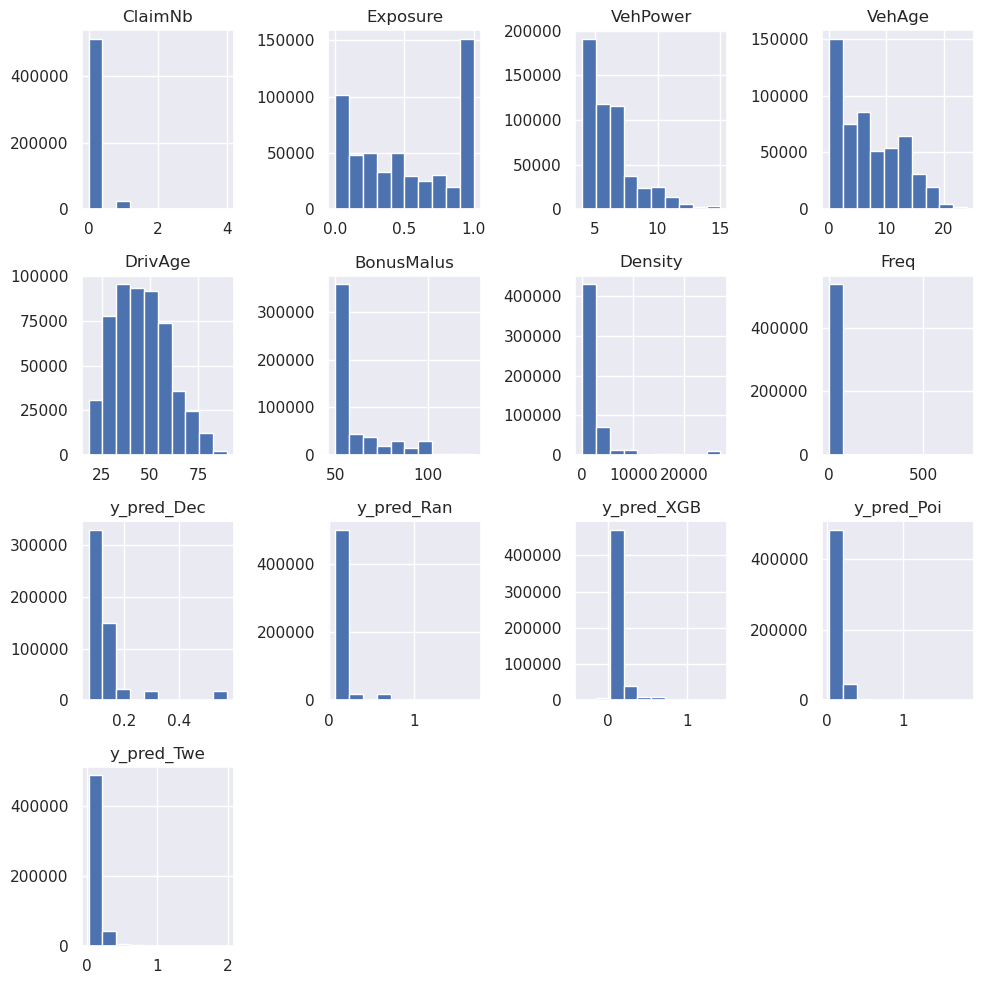

In [87]:
df_train_pred.hist(figsize=(10,10)) 
plt.tight_layout()
plt.show()

### Feature importance dla modeli ML i GLM - zmienne, które najbardziej różnicują predykcje

In [88]:
feature_importances

,feature,DecisionTreeRegressor,RandomForestRegressor,XGBRegressor
0,VehBrand,0.124971,0.124496,0.244475
1,VehPower,0.006516,0.004609,0.047626
2,VehGas,0.173866,0.173787,0.378465
3,RegName,0.000000,0.000132,0.025116
4,Area,0.000000,0.000000,0.000000
5,VehAge,0.399498,0.397155,0.158684
6,DrivAge,0.000000,0.006559,0.028298
7,BonusMalus,0.295149,0.293262,0.102910
8,Density,0.000000,0.000000,0.014426


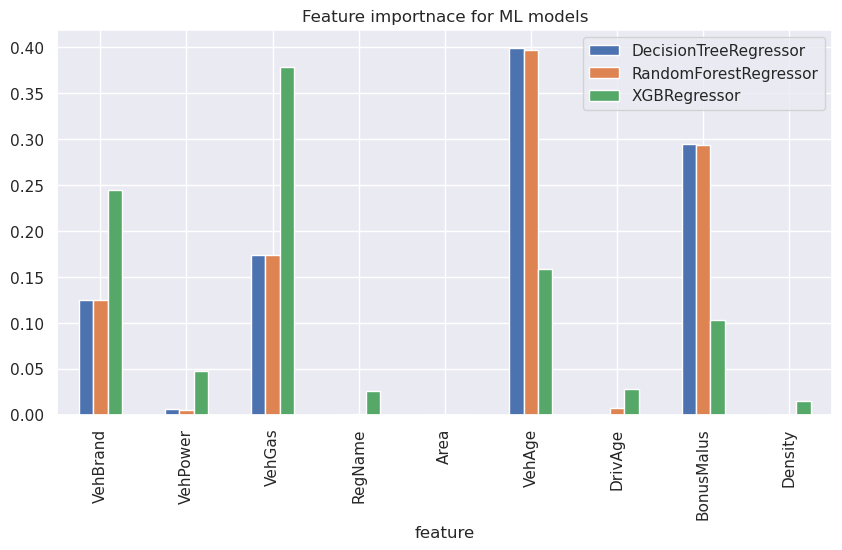

In [89]:
plot = feature_importances.plot.bar(x='feature',figsize=(10, 5))
plt.title("Feature importnace for ML models")
plt.show()

In [90]:
feature_coef

,feature,PoissonRegressor,TweedieRegressor
0,Density,0.029330,0.030078
1,BonusMalus,0.023608,0.024577
2,VehAge_0.0,1.018437,1.055080
3,VehAge_1.0,-0.116355,-0.096677
4,VehAge_2.0,-0.068829,-0.058385
...,...,...,...
61,Area_B,0.000327,-0.004356
62,Area_C,0.001463,0.000769
63,Area_D,0.031391,0.028123
64,Area_E,0.021604,0.026257


In [91]:
feature_coef[["PoissonRegressor", "TweedieRegressor"]] = feature_coef[["PoissonRegressor", "TweedieRegressor"]].apply(lambda x: np.abs(x))
feature_coef["category"] = feature_coef["feature"].apply(lambda x: x.split("_")[0])
feature_coef

,feature,PoissonRegressor,TweedieRegressor,category
0,Density,0.029330,0.030078,Density
1,BonusMalus,0.023608,0.024577,BonusMalus
2,VehAge_0.0,1.018437,1.055080,VehAge
3,VehAge_1.0,0.116355,0.096677,VehAge
4,VehAge_2.0,0.068829,0.058385,VehAge
...,...,...,...,...
61,Area_B,0.000327,0.004356,Area
62,Area_C,0.001463,0.000769,Area
63,Area_D,0.031391,0.028123,Area
64,Area_E,0.021604,0.026257,Area


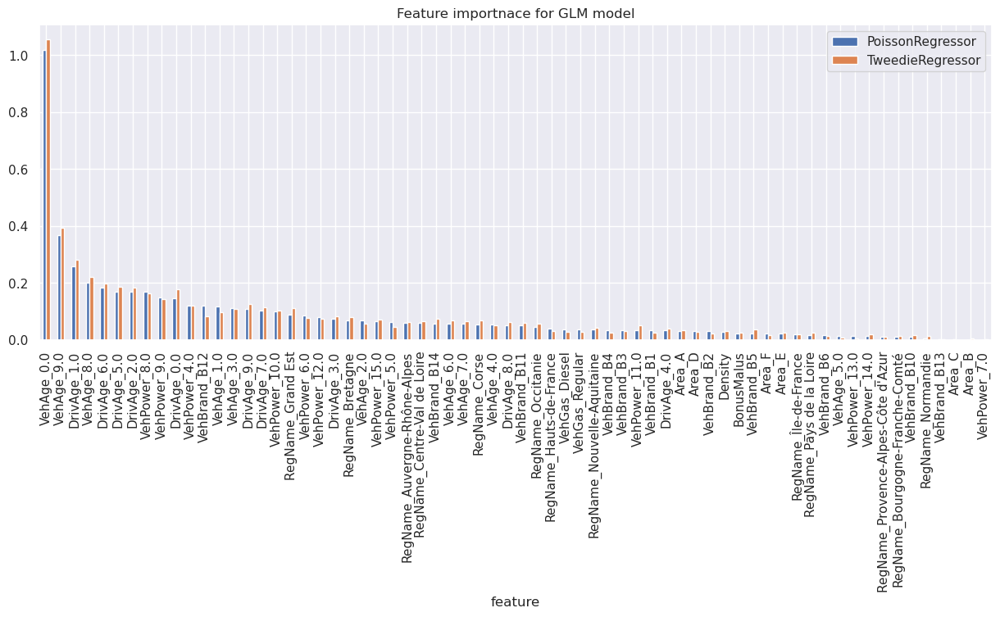

In [94]:
feature_coef[["feature","PoissonRegressor","TweedieRegressor"]].sort_values(by="PoissonRegressor",ascending=False).plot.bar(x='feature',figsize=(15, 5))
plt.title("Feature importnace for GLM model")
plt.show()

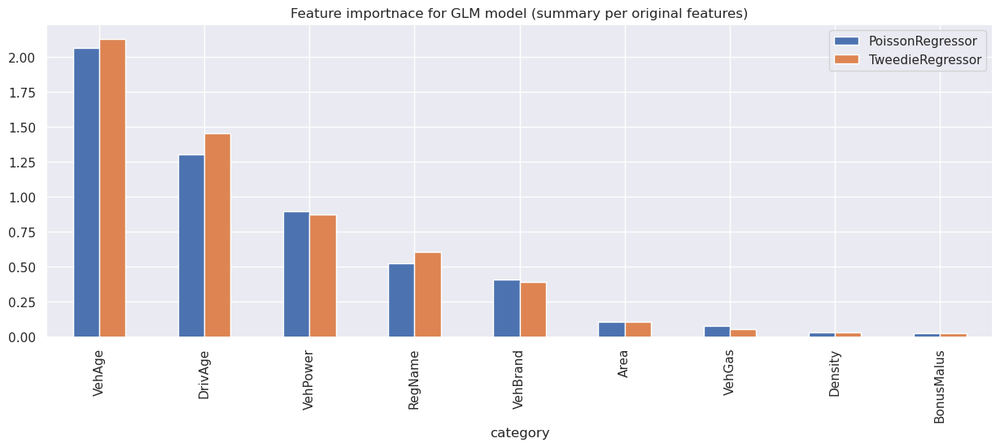

In [103]:
# Sumarycznie
feature_coef.groupby("category").sum().sort_values(by="TweedieRegressor", ascending=False).plot.bar(figsize=(15, 5))
plt.title("Feature importnace for GLM model (summary per original features)")
plt.show()

### Wnioski
* Spośród badanych machine learningowych modeli najmniejszą wartość błędu (MAE, MSE i mean Poisson deviance) na teście osiągnął XGBoostRegressor.
* Wszystkie modele nie poradziły sobie z symulowaniem wartością częstości znacznie większych niż 2. Rozkład przewidzianych wartości częstości znajduje się w zakresie 0-600, natomiast dla wymodelowanych wartości nie przekraczają one 2.
* Analiza istotności cech branych pod uwagę podczas uczenia modelu wykazała, że dla wszystkich największą istotności w przewidywaniu wartości miały: wiek samochodu, wartość funkcji BonusManus, rodzaj silnika a także marka samochodu - dla modeli ML.
* Dla modelu GLM, sumarycznie największy wpływ miały wiek samochodu, kierowcy, moc auta a dalej region i marka - widać tu zatem wyraźne różnice w porównaniu do modeli ML.
* Skalowanie danych z użyciem MinMaxScaler() nie wpłynęło na wyniki (dla modeli ML).
* Zastosowane modele sa modelami podstawowymi. Jedną z możliwych metod jest optymalizacja hiperparametrów modeli (zwłaszcza dla tego, który osiągnął najlepsze rezultaty w przewidywaniu częstości szkód). 
* Nie obserwujemy przeuczenia modeli (wartość błędu na zbiorze testowym jest niższa niż na treningowym).

### Segmenty klientów (cechy), dla których predykcje są najdokładniejsze (wybrane cechy)

In [174]:
def plot_predicted_fq(data:df, feature:str,predictions:list,):
    
    temp = data.groupby(by=feature).agg(
        {"Freq":'mean',
         "y_pred_XGB":"mean",
         "y_pred_Dec":"mean",
         "y_pred_Ran":"mean",
          "y_pred_Poi":	"mean",
         'Exposure':'sum'}).reset_index()

    temp['Rank'] = temp[feature].rank(method='dense') - 1

    fig, ax1 = plt.subplots(figsize=(15, 10))
    sns.barplot(x=feature, y='Exposure', data=temp, estimator=sum, order=sorted(temp[feature].unique()), alpha=0.5, ax=ax1)
    if len(temp[feature].unique()) > 12:
        ax1.bar_label(ax1.containers[0],rotation=90)
    else:
        ax1.bar_label(ax1.containers[0],rotation=0)
    ax1.set_xticklabels(sorted(temp[feature].unique()))
    if len(temp[feature].unique()) > 12:
        ax1.tick_params(axis='x', rotation=90)

    ax2 = ax1.twinx()
    sns.lineplot(x='Rank', y='Freq', data=temp, label='Observed', marker='o', markersize=7, ax=ax2)
    ax2.legend(loc='center right',bbox_to_anchor=(1.0, 0.9))

    ax3 = ax2.twinx()
    ax2.yaxis.set_visible(False)
    sns.lineplot(x='Rank', y='y_pred_XGB', data=temp, label='XGBoost', marker='o', markersize=7, color='red', ax=ax3)
    ax3.legend(loc='center right',bbox_to_anchor=(1.0, 0.8))

    ax4 = ax3.twinx()
    ax3.yaxis.set_visible(False)
    sns.lineplot(x='Rank', y='y_pred_Ran', data=temp, label='DecisionTree', marker='o', markersize=7, color='green', ax=ax4)
    ax4.legend(loc='center right',bbox_to_anchor=(1.0, 0.7))

    ax5 = ax4.twinx()
    ax4.yaxis.set_visible(False)
    sns.lineplot(x='Rank', y='y_pred_Ran', data=temp, label='RandomForrest', marker='o', markersize=7, color='purple', ax=ax5)
    ax5.legend(loc='center right',bbox_to_anchor=(1.0, 0.6))

    ax6 = ax5.twinx()
    ax5.yaxis.set_visible(False)
    sns.lineplot(x='Rank', y='y_pred_Poi', data=temp, label='Poisson', marker='o', markersize=7, color='black', ax=ax6)
    ax6.legend(loc='center right',bbox_to_anchor=(1.0, 0.5))

    plt.ylabel("Frequency")
    plt.title('Mean frequency and sum of Exposure by ' + feature + ' (observed vs. predicted with ML models)')
    plt.tight_layout()
    plt.show()


#### Marka auta

* Wszystkie modele bardzo dobrze prognozują klientów o najniższym i najwyższym ryzyku (ze względu na markę ubezpieczanego samochodu). Są to odpowiednio marki B14 i B12. Model XGB radzi sobie lepiej z pozostałymi markami niż modele drzewiaste i GLM. Prognozy dla posiadaczy aut marek B10 są obarczone największym błędem dla wszystkich modeli, podobnie jak B5 - tutaj jednak model GLM bardzo dobrze prognozuję wartość częstości.

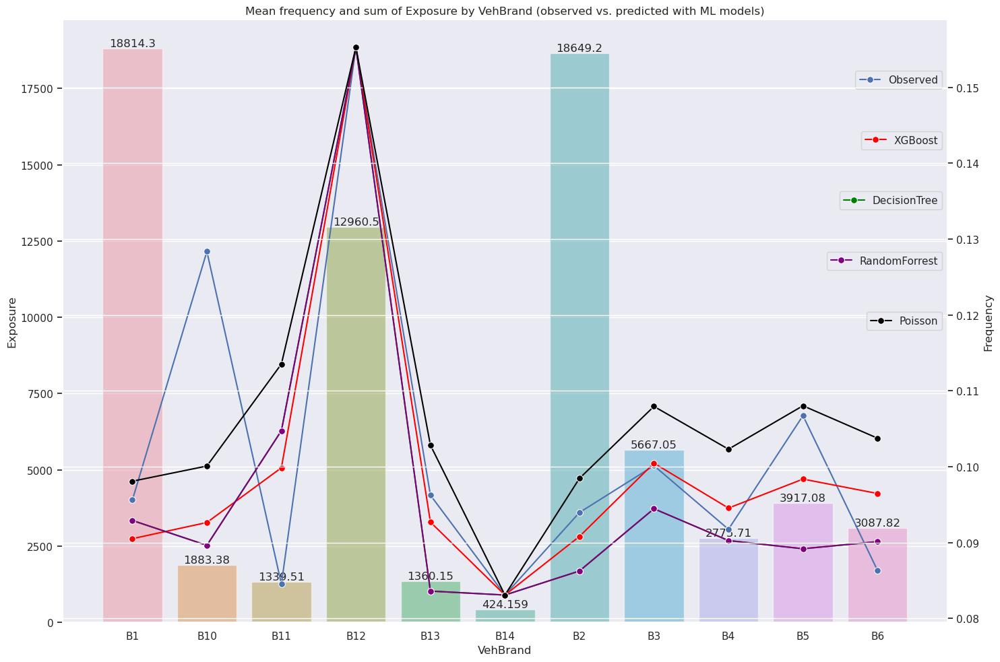

In [189]:
plot_predicted_fq(df_test_pred, 'VehBrand')

#### Rodzaj silnika

* Wszystkie modele bardzo dobrze prognozuja klientów o najniższym i najwyższym ryzyku. Samochody z silnikami typu diesla średnio mają nieznacznie mniej zgłoszonych zdarzeń drogowych. 

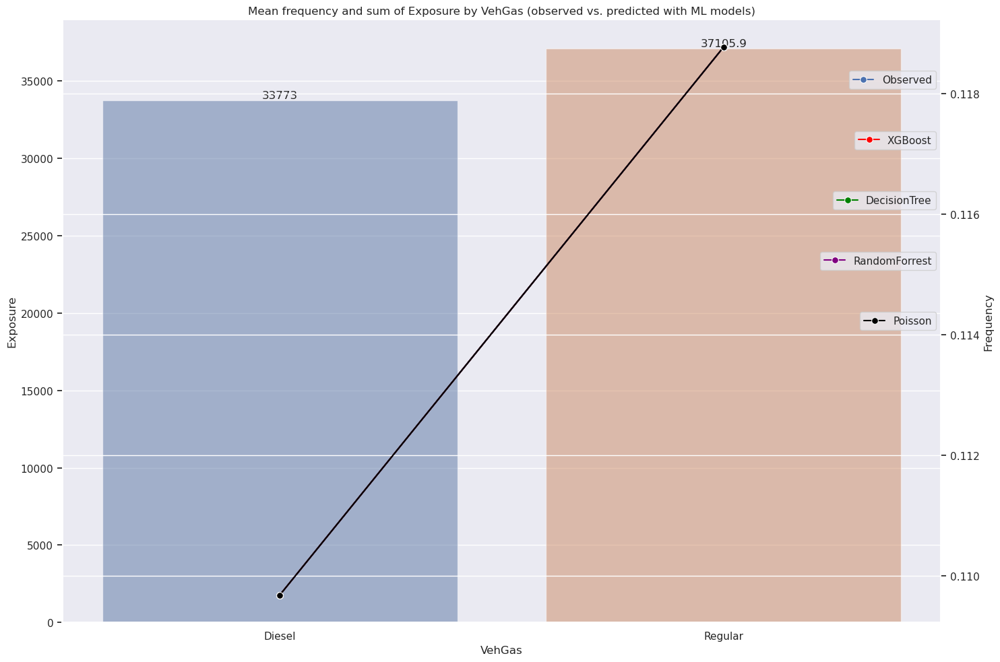

In [190]:
plot_predicted_fq(df_test_pred,'VehGas')

#### Wiek samochodu

* Model XGBoost bardzo dorze prognozuje częstość szkód w oparciu o wiek auta, model GLM nieznacnie gorzej. Wraz z wiekiem auta maleje częstość zgłoszeń. Największe jest ono dla samochodów poniżej 1 roku. Modele bardzo dobrze pozwalają przewidzieć grupy klientów najwyższego i największego ryzyka (wartości wysokiej częstości).

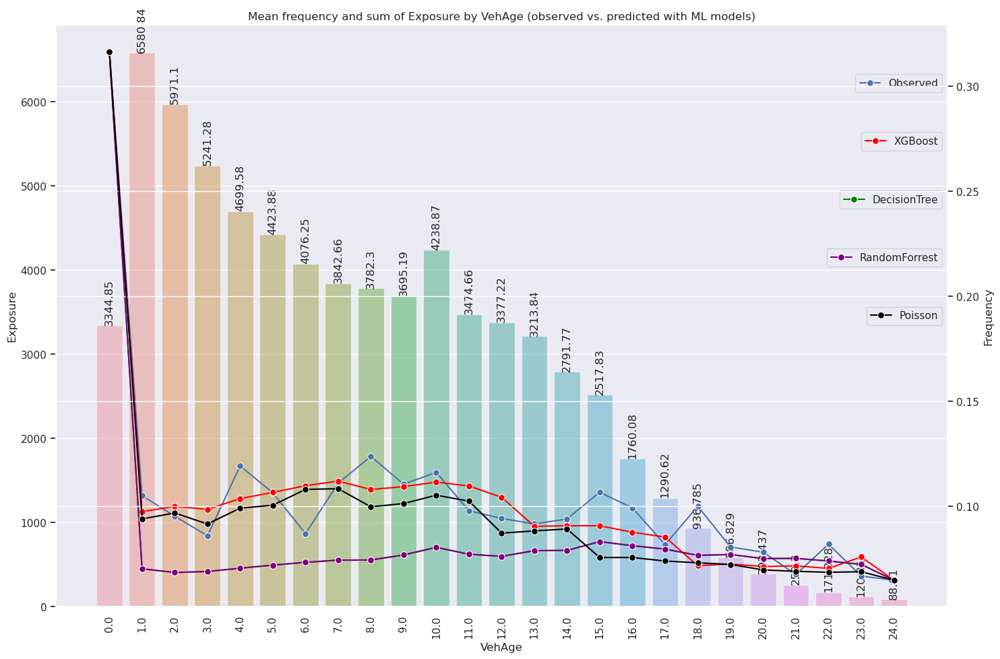

In [191]:
plot_predicted_fq(df_test_pred,'VehAge')

#### Wiek kierowcy

* Jest to jedna z cech, która zgodnie z wykresem feature importance nie miała dużego znaczenia przy trenowaniu modelu ML, odwrotnie niż GLM. W istocie, predykcje oparte o wiek kierowcy nie sa dokładne dla modeli ML. Model GLM daje bardzo dobre predykcje dla większości grup wiekowych, najmniej dokłade są te dla kierowców w wieku od 70 do 80.
* Zmniejszenie liczby grup wiekowych mogłoby pozwolić na lepszą analizę (wizualną ocenę na wykresie).

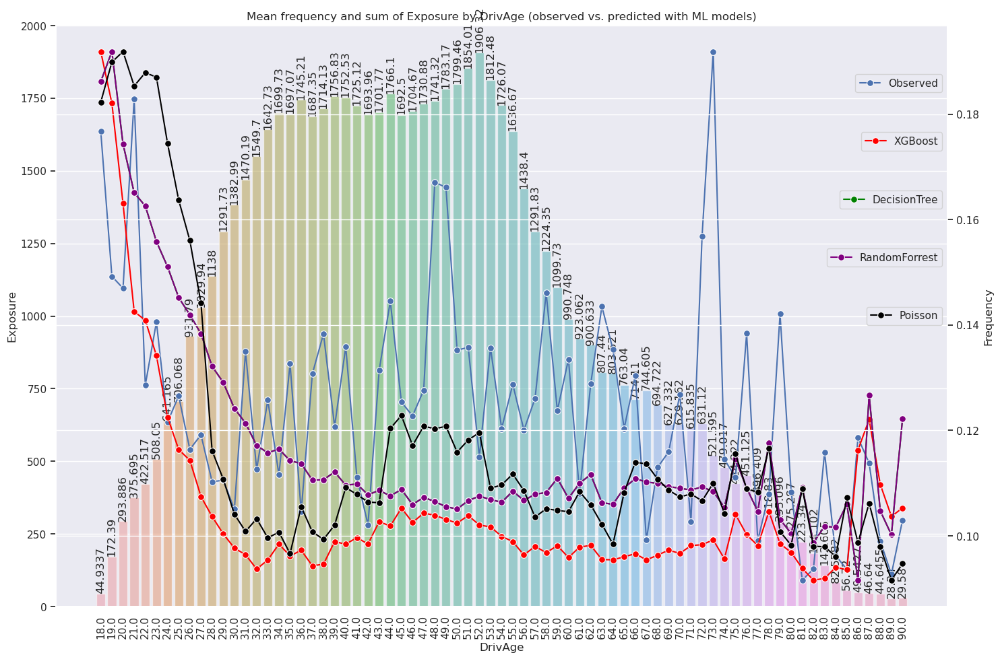

In [192]:
plot_predicted_fq(df_test_pred,'DrivAge')

#### Region

* Jest to jedna z cech, która zgodnie z wykresem feature importance nie miała dużego znaczenia przy trenowaniu modeli ML i niewielki dla modelu GLM. Modele pozwalają dość dokładnie oszacować częstość możliwych zgłoszeń w przypadku regionów o najniższej częstości ich występowania Centre.. i Pays ... przy czym model GLM jest najdokładniejszy.
W przypadku regionów o wysokiej obserwowanej częstości zgłoszeń: Bourogne .. oraz Ilede-France dokładne predycje z wykorzystaniem modelu GML można wyznaczyć tylko dla drugiego.  nich.

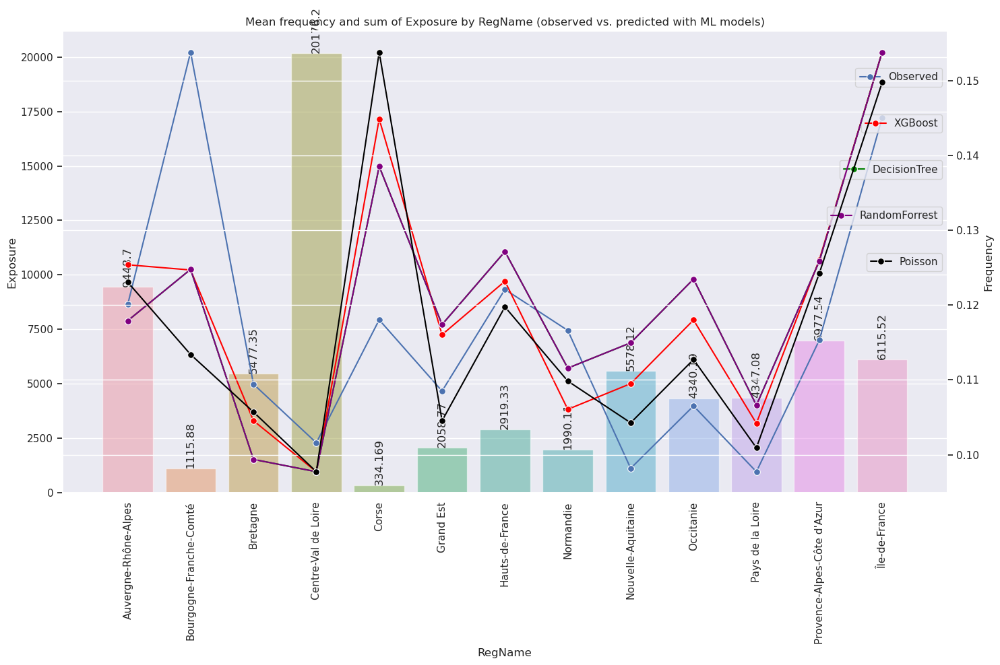

In [193]:
plot_predicted_fq(df_test_pred,'RegName')

## Możliwe metody ulepszenia prognoz

* Zastosowanie modeli deep learningowych, zwłaszcza opartych o sekwencyjne sieci neuronowe, 
* Przekształcenie problemu z regresyjnego na klasyfikacyjny (multiklasyfikacja na niezbalansowanym zbiorze danych), gdzie za klasy uznać by można klientów z 0, 1, 2, 3 oraz 4 i więcej zgłoszonymi zdarzeniami drogowymi w trakcie trwania polisy (okres trwania polisy również można tu zastosować jako 'wagę' próbki).
* Przebadania szerszej gamy modeli ML i GLM.
* Optymalizacja hiperparametrów zasotoswanych modeli.